## Analysis v4

In [1]:
import os
import textwrap
import pandas as pd
import seaborn as sns
import statsmodels.api as sm
import matplotlib.pyplot as plt
from natsort import index_natsorted

### Calculating the Variance of the AF and FPS values 

It would be quite interesting to see if for each variant site per motif, the variance of the AF and FPS values are correlated.

I.e. if a variant site has a high variance in AF values, does it also have a high variance in FPS values?

First, load the data file as dataframe and then truncate the columns to include on AF and FPS data. Next, convert the dataframe into long format.

In [2]:
# import the data
# filepath = '/home/users/ntu/suffiazi/scratch/outputs/tmp/input_data/E2F5_E2F5_HUMAN.H11MO.0.B_fpscore-af-varsites-combined-matrix-wide.tsv'
filepath = '../output-data/combined_matrix/TFDP1_M08108_2.00_fpscore-af-varsites-combined-matrix-wide.tsv'
matrix_afps = pd.read_csv(filepath, sep='\t')
# extract motif id from filename
motif_id = os.path.basename(filepath).replace('_fpscore-af-varsites-combined-matrix-wide.tsv', '')
motif_id

'TFDP1_M08108_2.00'

In [3]:
matrix_afps.head()

,Chromosome,Start,End,98JKPD8_lumA_fps,ANAB5F7_basal_fps,S6R691V_her2_fps,PU24GB8_lumB_fps,2GAMBDQ_norm_fps,2GAMBDQ_norm_varsite_pos,2GAMBDQ_norm_ref_allele,...,ANAB5F7_basal_AF,PU24GB8_lumB_varsite_pos,PU24GB8_lumB_ref_allele,PU24GB8_lumB_alt_allele,PU24GB8_lumB_AF,S6R691V_her2_varsite_pos,S6R691V_her2_ref_allele,S6R691V_her2_alt_allele,S6R691V_her2_AF,region_id
0,chr1,191257,191268,0.00000,0.00000,0.00000,0.00000,0.00000,NaN,NaN,...,0.000000,191258.0,G,C,0.026316,NaN,NaN,NaN,0.000000,chr1:191257-191268
1,chr1,818021,818032,0.02966,0.04399,0.02131,0.03470,0.03443,818025.0,C,...,0.812500,818025.0,C,A,0.833333,818025.0,C,A,0.900000,chr1:818021-818032
2,chr1,818780,818791,0.02572,0.02376,0.02271,0.02814,0.03391,NaN,NaN,...,0.033333,818783.0,T,C,0.055556,818783.0,T,C,0.062500,chr1:818780-818791
3,chr1,960570,960581,0.28046,0.33500,0.28495,0.27618,0.22986,NaN,NaN,...,0.000000,NaN,NaN,NaN,0.000000,NaN,NaN,NaN,0.000000,chr1:960570-960581
4,chr1,977015,977026,1.10047,0.50514,0.71035,1.21305,1.30155,977023.0,G,...,0.941176,977023.0,G,A,0.947368,977023.0,G,A,0.911765,chr1:977015-977026


Let's filter the loaded table to include only the `_AF` and `_fps` columns, as well as the `region_id` column.

In [4]:
afps_df = matrix_afps.filter(regex='_AF$|_fps$|_id$').copy()
afps_df.head(5)

,98JKPD8_lumA_fps,ANAB5F7_basal_fps,S6R691V_her2_fps,PU24GB8_lumB_fps,2GAMBDQ_norm_fps,2GAMBDQ_norm_AF,98JKPD8_lumA_AF,ANAB5F7_basal_AF,PU24GB8_lumB_AF,S6R691V_her2_AF,region_id
0,0.00000,0.00000,0.00000,0.00000,0.00000,0.000,0.000000,0.000000,0.026316,0.000000,chr1:191257-191268
1,0.02966,0.04399,0.02131,0.03470,0.03443,0.875,0.900000,0.812500,0.833333,0.900000,chr1:818021-818032
2,0.02572,0.02376,0.02271,0.02814,0.03391,0.000,0.125000,0.033333,0.055556,0.062500,chr1:818780-818791
3,0.28046,0.33500,0.28495,0.27618,0.22986,0.000,0.041667,0.000000,0.000000,0.000000,chr1:960570-960581
4,1.10047,0.50514,0.71035,1.21305,1.30155,1.000,1.000000,0.941176,0.947368,0.911765,chr1:977015-977026


In [5]:
# convert to long format
afps_df_long = afps_df.melt(id_vars=["region_id"], var_name="variable", value_name="value")

# split the variable column into sample_id and type columns using reverse split string method, which returns a dataframe of columns based on the number of splits (n=x); this can directly be assigned to new columns in the original dataframe
afps_df_long[['sample_id', 'type']] = afps_df_long['variable'].str.rsplit('_', n=1, expand=True)

# drop the redundant 'variable' column
afps_df_long = afps_df_long.drop(columns=["variable"])

# now pivot the dataframe to create new columns based on the type column
afps_df_lpv = afps_df_long.pivot(index=['region_id', 'sample_id'], columns='type', values='value').reset_index()

# remove the index name and rename the columns to match the type values
afps_df_lpv = afps_df_lpv.rename_axis(None, axis=1).rename(columns={'fps': 'FPS'})

# sort the dataframe by region_id naturally
afps_df_lpv = afps_df_lpv.reindex(index=index_natsorted(afps_df_lpv['region_id']))
afps_df_lpv = afps_df_lpv.reset_index(drop=True)
afps_df_lpv

,region_id,sample_id,AF,FPS
0,chr1:191257-191268,2GAMBDQ_norm,0.000000,0.0
1,chr1:191257-191268,98JKPD8_lumA,0.000000,0.0
2,chr1:191257-191268,ANAB5F7_basal,0.000000,0.0
3,chr1:191257-191268,PU24GB8_lumB,0.026316,0.0
4,chr1:191257-191268,S6R691V_her2,0.000000,0.0
...,...,...,...,...
47795,chrY:11108019-11108030,2GAMBDQ_norm,0.437500,0.0
47796,chrY:11108019-11108030,98JKPD8_lumA,0.100000,0.0
47797,chrY:11108019-11108030,ANAB5F7_basal,0.382353,0.0
47798,chrY:11108019-11108030,PU24GB8_lumB,0.264706,0.0


In [6]:
# afps_df_lpv[afps_df_lpv['sample_id'] == '2GAMBDQ_norm'].describe()

### AF–FPS Matrix
At this point, we now have both a matrix of AF and FPS values in wide form (`afps_df`) and the same dataset in long form (`afps_df_lpv`). We can scale the FPS values to be between 0 and 1 now.

In [6]:
# use MinMaxScaler to scale the raw fps values to range between 0 and 1
from sklearn.preprocessing import MinMaxScaler
# scale the FPS values to a range of 0-1
# Initialize a MinMaxScaler
scaler = MinMaxScaler()

# copy df
fps_df_scaled = matrix_afps.filter(regex='_fps$|_id$').copy()

# set the index to 'region_id'
fps_df_scaled = fps_df_scaled.set_index('region_id')

# Fit the MinMaxScaler to the 'FPS' column and transform it
fps_df_scaled = pd.DataFrame(scaler.fit_transform(fps_df_scaled), columns=fps_df_scaled.columns, index=fps_df_scaled.index)

# rename columns by adding '_scaled' to the column names
fps_df_scaled = fps_df_scaled.add_suffix('_scaled')
fps_df_scaled

,98JKPD8_lumA_fps_scaled,ANAB5F7_basal_fps_scaled,S6R691V_her2_fps_scaled,PU24GB8_lumB_fps_scaled,2GAMBDQ_norm_fps_scaled
region_id,,,,,
chr1:191257-191268,0.000000,0.000000,0.000000,0.000000,0.000000
chr1:818021-818032,0.007823,0.011176,0.002785,0.009443,0.009147
chr1:818780-818791,0.006783,0.006036,0.002968,0.007658,0.009009
chr1:960570-960581,0.073969,0.085110,0.037244,0.075158,0.061066
chr1:977015-977026,0.290240,0.128336,0.092845,0.330112,0.345779
...,...,...,...,...,...
chrX:153934861-153934872,0.051878,0.042657,0.022497,0.051831,0.042934
chrX:154444629-154444640,0.012923,0.018879,0.009550,0.024527,0.011246
chrX:155010397-155010408,0.003104,0.001263,0.001144,0.003532,0.005279


Now we should convert the FPS scaled dataframe into long form.

In [7]:
# reset index
fps_df_scaled_long = fps_df_scaled.reset_index()
# convert to long format
fps_df_scaled_long = fps_df_scaled_long.melt(id_vars=["region_id"], var_name="variable", value_name="value")

# split the variable column into sample_id and type columns using reverse split string method, which returns a dataframe of columns based on the number of splits (n=x); this can directly be assigned to new columns in the original dataframe
# Split the 'variable' column into three parts
fps_df_scaled_long[['part1', 'part2', 'part3']] = fps_df_scaled_long['variable'].str.rsplit('_', n=2, expand=True)

# Assign part1 to 'sample_id' and concatenate the other parts to form 'type'
fps_df_scaled_long['sample_id'] = fps_df_scaled_long['part1']
fps_df_scaled_long['type'] = fps_df_scaled_long['part2'].str.upper() + '_' + fps_df_scaled_long['part3']

# Drop the unnecessary columns
fps_df_scaled_long = fps_df_scaled_long.drop(['variable', 'part1', 'part2', 'part3'], axis=1)

# now pivot the dataframe to create new columns based on the type column
fps_df_scaled_lpv = fps_df_scaled_long.pivot(index=['region_id', 'sample_id'], columns='type', values='value').reset_index()

# remove the index name and rename the columns to match the type values
fps_df_scaled_lpv = fps_df_scaled_lpv.rename_axis(None, axis=1)

# sort the dataframe by region_id naturally
fps_df_scaled_lpv = fps_df_scaled_lpv.reindex(index=index_natsorted(fps_df_scaled_lpv['region_id']))
fps_df_scaled_lpv = fps_df_scaled_lpv.reset_index(drop=True)
fps_df_scaled_lpv

,region_id,sample_id,FPS_scaled
0,chr1:191257-191268,2GAMBDQ_norm,0.0
1,chr1:191257-191268,98JKPD8_lumA,0.0
2,chr1:191257-191268,ANAB5F7_basal,0.0
3,chr1:191257-191268,PU24GB8_lumB,0.0
4,chr1:191257-191268,S6R691V_her2,0.0
...,...,...,...
47795,chrY:11108019-11108030,2GAMBDQ_norm,0.0
47796,chrY:11108019-11108030,98JKPD8_lumA,0.0
47797,chrY:11108019-11108030,ANAB5F7_basal,0.0
47798,chrY:11108019-11108030,PU24GB8_lumB,0.0


/Users/sufyazi/Applications/bin/miniforge3/envs/quarto-docs/lib/python3.12/site-packages/seaborn/_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
/Users/sufyazi/Applications/bin/miniforge3/envs/quarto-docs/lib/python3.12/site-packages/seaborn/_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
/Users/sufyazi/Applications/bin/miniforge3/envs/quarto-docs/lib/python3.12/site-packages/seaborn/_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to sile

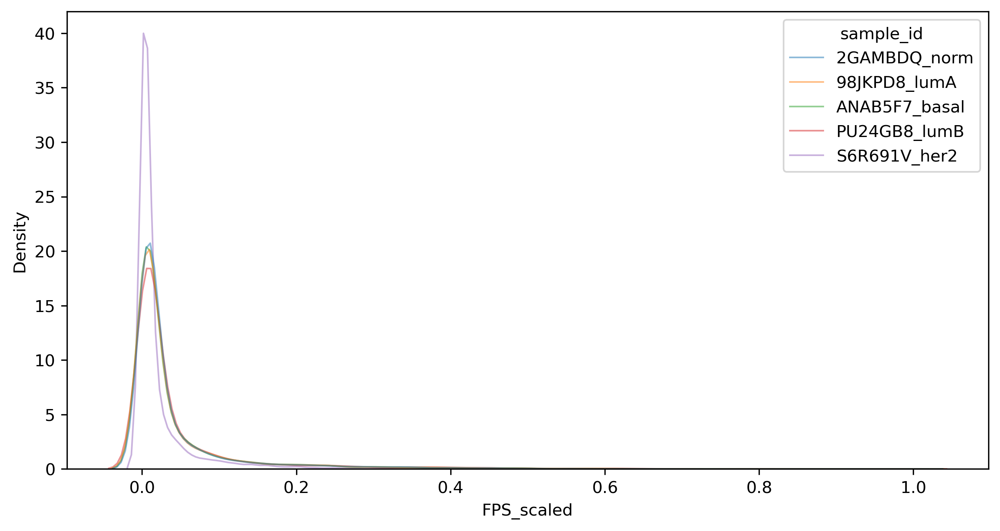

In [8]:
# plot fps distribution
plt.figure(figsize=(10, 5), dpi=300)
sns.kdeplot(data=fps_df_scaled_lpv, x="FPS_scaled", hue="sample_id", fill=False, common_norm=False, alpha=.5, linewidth=1)
plt.show()

### Merging `afps_df_lpv` and `fps_df_scaled_lpv`

Now we can merge the two long dataframes together to get both raw FPS and scaled FPS values in one dataframe.

In [9]:
afps_df_lpv

,region_id,sample_id,AF,FPS
0,chr1:191257-191268,2GAMBDQ_norm,0.000000,0.0
1,chr1:191257-191268,98JKPD8_lumA,0.000000,0.0
2,chr1:191257-191268,ANAB5F7_basal,0.000000,0.0
3,chr1:191257-191268,PU24GB8_lumB,0.026316,0.0
4,chr1:191257-191268,S6R691V_her2,0.000000,0.0
...,...,...,...,...
47795,chrY:11108019-11108030,2GAMBDQ_norm,0.437500,0.0
47796,chrY:11108019-11108030,98JKPD8_lumA,0.100000,0.0
47797,chrY:11108019-11108030,ANAB5F7_basal,0.382353,0.0
47798,chrY:11108019-11108030,PU24GB8_lumB,0.264706,0.0


In [10]:
fps_df_scaled_lpv

,region_id,sample_id,FPS_scaled
0,chr1:191257-191268,2GAMBDQ_norm,0.0
1,chr1:191257-191268,98JKPD8_lumA,0.0
2,chr1:191257-191268,ANAB5F7_basal,0.0
3,chr1:191257-191268,PU24GB8_lumB,0.0
4,chr1:191257-191268,S6R691V_her2,0.0
...,...,...,...
47795,chrY:11108019-11108030,2GAMBDQ_norm,0.0
47796,chrY:11108019-11108030,98JKPD8_lumA,0.0
47797,chrY:11108019-11108030,ANAB5F7_basal,0.0
47798,chrY:11108019-11108030,PU24GB8_lumB,0.0


In [11]:
# merge two dataframes on region_id and sample_id
afps_full_dfl = afps_df_lpv.merge(fps_df_scaled_lpv, on=['region_id', 'sample_id'])
afps_full_dfl

,region_id,sample_id,AF,FPS,FPS_scaled
0,chr1:191257-191268,2GAMBDQ_norm,0.000000,0.0,0.0
1,chr1:191257-191268,98JKPD8_lumA,0.000000,0.0,0.0
2,chr1:191257-191268,ANAB5F7_basal,0.000000,0.0,0.0
3,chr1:191257-191268,PU24GB8_lumB,0.026316,0.0,0.0
4,chr1:191257-191268,S6R691V_her2,0.000000,0.0,0.0
...,...,...,...,...,...
47795,chrY:11108019-11108030,2GAMBDQ_norm,0.437500,0.0,0.0
47796,chrY:11108019-11108030,98JKPD8_lumA,0.100000,0.0,0.0
47797,chrY:11108019-11108030,ANAB5F7_basal,0.382353,0.0,0.0
47798,chrY:11108019-11108030,PU24GB8_lumB,0.264706,0.0,0.0


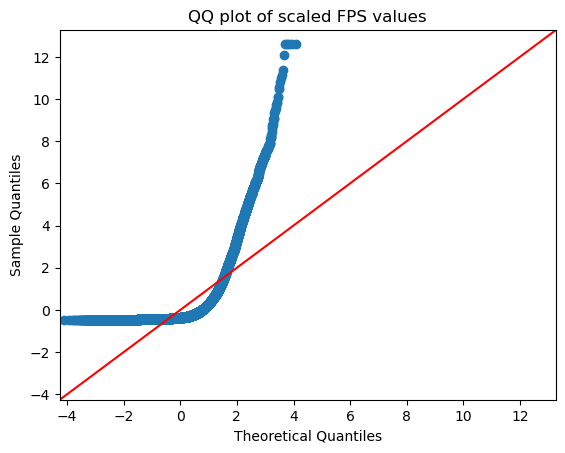

In [12]:
fig = sm.qqplot(afps_full_dfl['FPS_scaled'], line='45', fit=True)
plt.title('QQ plot of scaled FPS values')
plt.show()

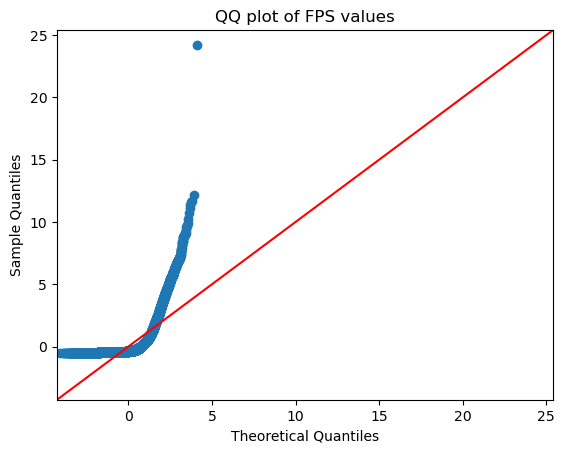

In [13]:
fig = sm.qqplot(afps_full_dfl['FPS'], line='45', fit=True)
plt.title('QQ plot of FPS values')
plt.show()

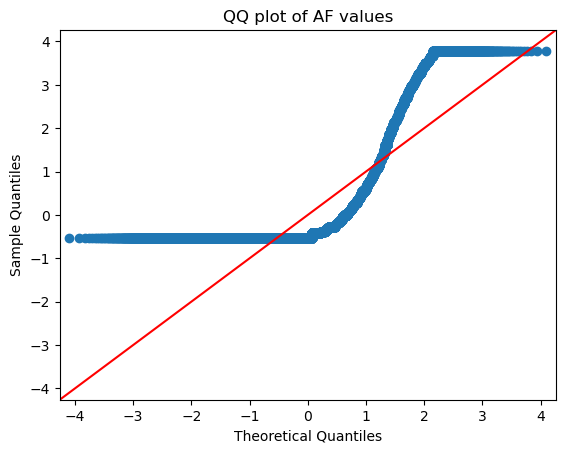

In [14]:
fig = sm.qqplot(afps_full_dfl['AF'], line='45', fit=True)
plt.title('QQ plot of AF values')
plt.show()

/Users/sufyazi/Applications/bin/miniforge3/envs/quarto-docs/lib/python3.12/site-packages/seaborn/_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
/Users/sufyazi/Applications/bin/miniforge3/envs/quarto-docs/lib/python3.12/site-packages/seaborn/_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
/Users/sufyazi/Applications/bin/miniforge3/envs/quarto-docs/lib/python3.12/site-packages/seaborn/_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to sile

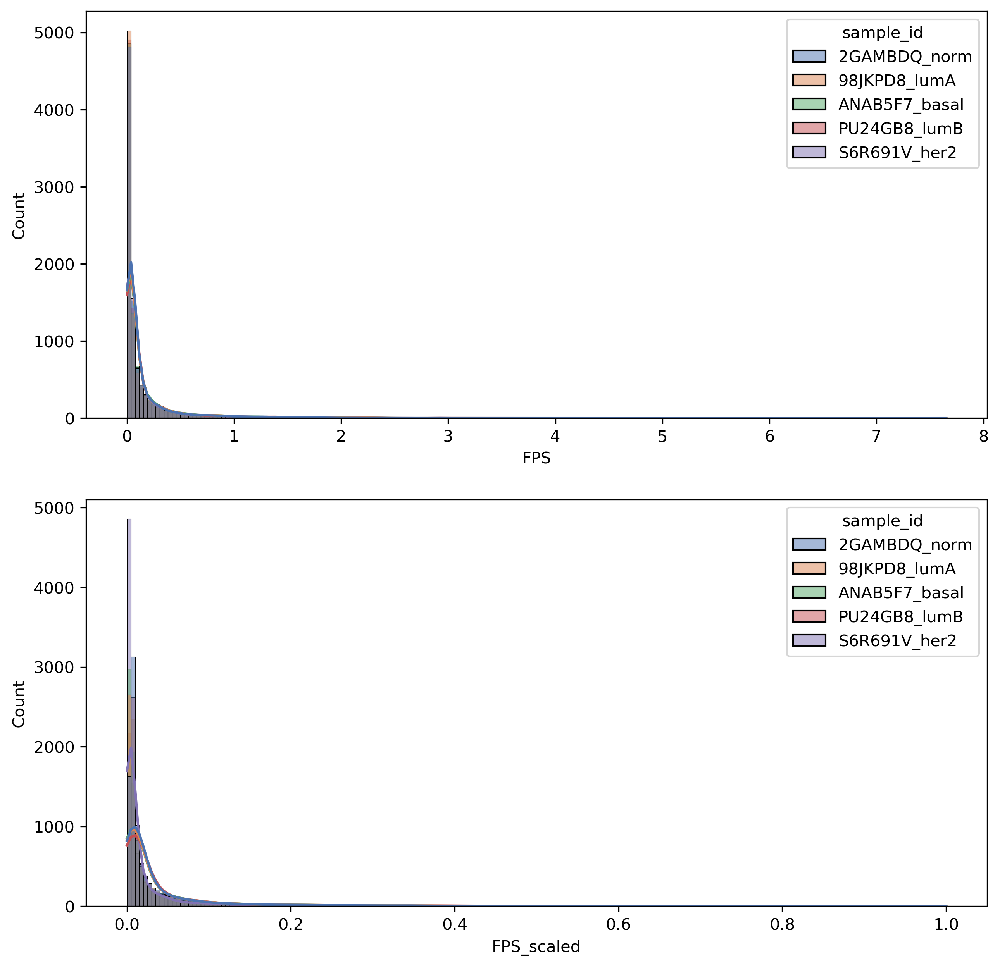

In [17]:
# Create a figure and a 2x2 grid of subplots
fig, axs = plt.subplots(2, 1, figsize=(10, 10), dpi=300)
sns.histplot(data=afps_full_dfl, x="FPS", hue="sample_id", bins=200, kde=True, palette="deep", ax=axs[0])
sns.histplot(data=afps_full_dfl, x="FPS_scaled", hue="sample_id", bins=200, kde=True, palette="deep", ax=axs[1])
# # now draw a subset plot where x is above a certain threshold
# sns.histplot(data=afps_full_dfl[afps_full_dfl['FPS'] > 0.5], x="FPS", hue="sample_id", bins=200, kde=True, palette="deep", ax=axs[2])
# plt.title(f"FPS distribution of {motif_id} in all samples")
plt.show()

In [16]:
# save to file
# afps_full_dfl.to_csv(f'/home/msazizan/hyperspace/gatk-workflow/plotting/output-data/AF-FPS_regionsorted_full_longtable/{motif_id}_afps_full_scaled_longtable.tsv', sep='\t', index=False)

/Users/sufyazi/Applications/bin/miniforge3/envs/quarto-docs/lib/python3.12/site-packages/seaborn/_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
/Users/sufyazi/Applications/bin/miniforge3/envs/quarto-docs/lib/python3.12/site-packages/seaborn/_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
/Users/sufyazi/Applications/bin/miniforge3/envs/quarto-docs/lib/python3.12/site-packages/seaborn/_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to sile

(-0.1, 1.1)

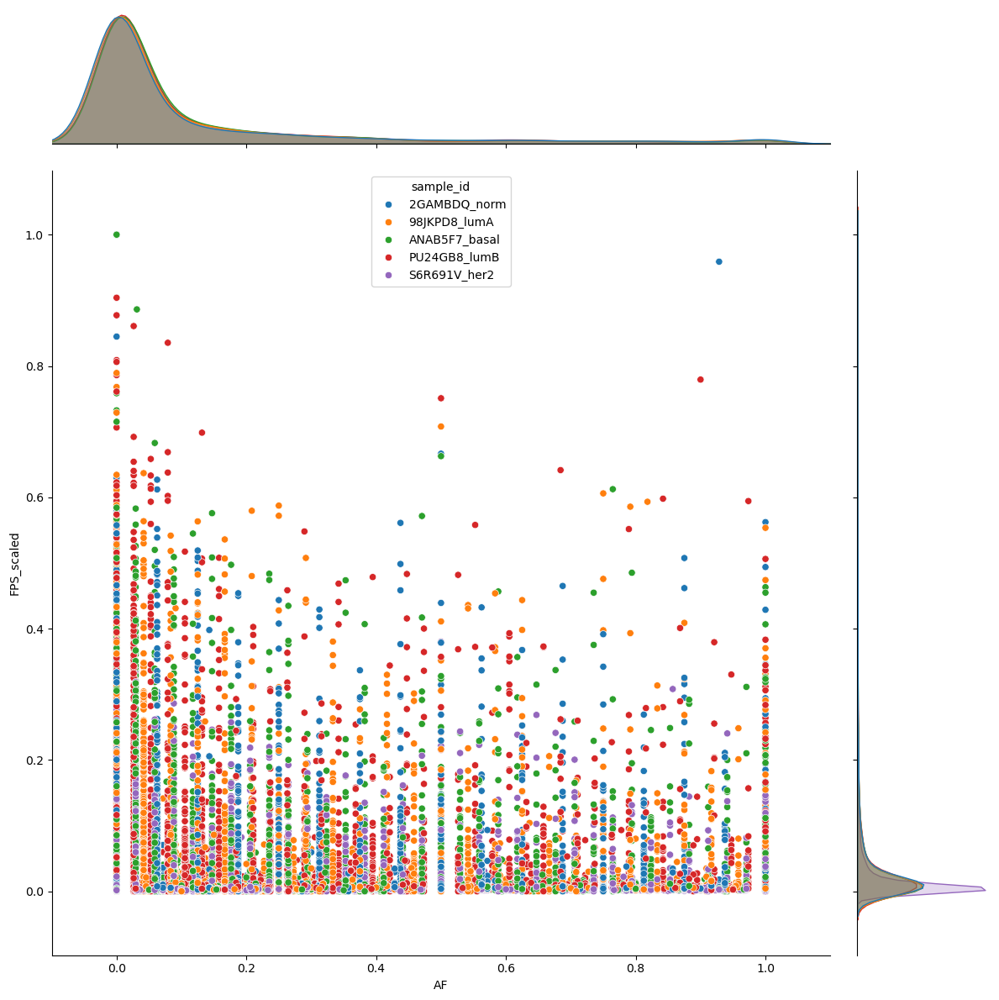

In [18]:
sns.jointplot(data=afps_full_dfl, x='AF', y='FPS_scaled', kind='scatter', hue='sample_id', height=12)
plt.xlim(-0.1, 1.1)

### Calculating Variation Statistics
With the full data table cleaned up into a long format, we can now calculate the variation statistics for each region. We will calculate the following statistics:
* variance (Var)
* ~~coefficient of variation (CV)~~
* ~~quartile coefficient of dispersion (QCD)~~

First calculate statistics on the raw FPS data.

In [19]:
# extract fps columns
fps_df = matrix_afps.filter(regex='_fps$|_id$').copy()
# calculate variance of fps values across samples per region_id and add to a new column called 'fps_var'
fps_df = fps_df.set_index('region_id')
fps_df['FPS_var'] = fps_df.var(axis=1)
# calculate the coefficient of variation (CV) of fps values across samples per region_id and add to a new column called 'fps_cv'
# fps_df['FPS_cv'] = fps_df.drop(columns=['FPS_var']).std(axis=1) / fps_df.drop(columns=['FPS_var']).mean(axis=1) * 100
# calculate the quartile coefficient of dispersion (QCD) of fps values across samples per region_id and add to a new column called 'fps_qcd'
# fps_df['FPS_qcd'] = (fps_df.drop(columns=['FPS_var', 'FPS_cv']).quantile(q=0.75, axis=1) - fps_df.drop(columns=['FPS_var', 'FPS_cv']).quantile(q=0.25, axis=1)) / (fps_df.drop(columns=['FPS_var', 'FPS_cv']).quantile(q=0.75, axis=1) + fps_df.drop(columns=['FPS_var', 'FPS_cv']).quantile(q=0.25, axis=1))
fps_df.head()

,98JKPD8_lumA_fps,ANAB5F7_basal_fps,S6R691V_her2_fps,PU24GB8_lumB_fps,2GAMBDQ_norm_fps,FPS_var
region_id,,,,,,
chr1:191257-191268,0.00000,0.00000,0.00000,0.00000,0.00000,0.000000
chr1:818021-818032,0.02966,0.04399,0.02131,0.03470,0.03443,0.000068
chr1:818780-818791,0.02572,0.02376,0.02271,0.02814,0.03391,0.000020
chr1:960570-960581,0.28046,0.33500,0.28495,0.27618,0.22986,0.001393
chr1:977015-977026,1.10047,0.50514,0.71035,1.21305,1.30155,0.117365


Then do the same on the fps scaled data.

In [20]:
# copy fps_df_scaled
fps_df_scaled_cp = fps_df_scaled.copy()
# calculate variance of fps_scaled values across samples per region_id and add to a new column called 'fps_scaled_var'
fps_df_scaled_cp['FPS_scaled_var'] = fps_df_scaled_cp.var(axis=1)
# calculate the coefficient of variation (CV) of fps values across samples per region_id and add to a new column called 'fps_scaled_cv'
# fps_df_scaled['FPS_scaled_cv'] = fps_df_scaled.drop(columns=['FPS_scaled_var']).std(axis=1) / fps_df_scaled.drop(columns=['FPS_scaled_var']).mean(axis=1) * 100
# calculate the quartile coefficient of dispersion (QCD) of fps values across samples per region_id and add to a new column called 'fps_scaled_qcd'
# fps_df_scaled['FPS_scaled_qcd'] = (fps_df_scaled.drop(columns=['FPS_scaled_var', 'FPS_scaled_cv']).quantile(q=0.75, axis=1) - fps_df_scaled.drop(columns=['FPS_scaled_var', 'FPS_scaled_cv']).quantile(q=0.25, axis=1)) / (fps_df_scaled.drop(columns=['FPS_scaled_var', 'FPS_scaled_cv']).quantile(q=0.75, axis=1) + fps_df_scaled.drop(columns=['FPS_scaled_var', 'FPS_scaled_cv']).quantile(q=0.25, axis=1))
fps_df_scaled_cp.head()

,98JKPD8_lumA_fps_scaled,ANAB5F7_basal_fps_scaled,S6R691V_her2_fps_scaled,PU24GB8_lumB_fps_scaled,2GAMBDQ_norm_fps_scaled,FPS_scaled_var
region_id,,,,,,
chr1:191257-191268,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
chr1:818021-818032,0.007823,0.011176,0.002785,0.009443,0.009147,0.000010
chr1:818780-818791,0.006783,0.006036,0.002968,0.007658,0.009009,0.000005
chr1:960570-960581,0.073969,0.085110,0.037244,0.075158,0.061066,0.000341
chr1:977015-977026,0.290240,0.128336,0.092845,0.330112,0.345779,0.013981


In [21]:
# Do the same for AF values
# extract af columns
af_df = matrix_afps.filter(regex='_AF$|_id$')
af_df = af_df.set_index('region_id')
# then calculate variance of af values across samples per region_id and add to a new column called 'af_var'
af_df['AF_var'] = af_df.var(axis=1)
af_df.head()

,2GAMBDQ_norm_AF,98JKPD8_lumA_AF,ANAB5F7_basal_AF,PU24GB8_lumB_AF,S6R691V_her2_AF,AF_var
region_id,,,,,,
chr1:191257-191268,0.000,0.000000,0.000000,0.026316,0.000000,0.000139
chr1:818021-818032,0.875,0.900000,0.812500,0.833333,0.900000,0.001576
chr1:818780-818791,0.000,0.125000,0.033333,0.055556,0.062500,0.002113
chr1:960570-960581,0.000,0.041667,0.000000,0.000000,0.000000,0.000347
chr1:977015-977026,1.000,1.000000,0.941176,0.947368,0.911765,0.001510


Now merge the statistics tables together on `region_id` index.

In [22]:
# subset only the fps stats columns
# fps_stats_df = fps_df.filter(regex='_var$|_cv$|_qcd$|_id$').copy()
# fps_scaled_stats_df = fps_df_scaled.filter(regex='_var$|_cv$|_qcd$|_id$').copy()
fps_stats_df = fps_df.filter(regex='_var$|_id$').copy()
fps_scaled_stats_df = fps_df_scaled_cp.filter(regex='_var$|_id$').copy()
af_stats_df = af_df.filter(regex='_var$|_id$').copy()
# merge on region_id index from both tables
fps_stats_df_temp = fps_stats_df.merge(fps_scaled_stats_df, left_index=True, right_index=True)
# now merge with af_df
afps_stats_df = fps_stats_df_temp.merge(af_stats_df, left_index=True, right_index=True)
afps_stats_df


,FPS_var,FPS_scaled_var,AF_var
region_id,,,
chr1:191257-191268,0.000000,0.000000,0.000139
chr1:818021-818032,0.000068,0.000010,0.001576
chr1:818780-818791,0.000020,0.000005,0.002113
chr1:960570-960581,0.001393,0.000341,0.000347
chr1:977015-977026,0.117365,0.013981,0.001510
...,...,...,...
chrX:153934861-153934872,0.000227,0.000144,0.000781
chrX:154444629-154444640,0.000388,0.000038,0.003363
chrX:155010397-155010408,0.000031,0.000003,0.027746


Now we have a table of stats data to merge with the longform AF_FPS table (`afps_full_dfl`).

In [23]:
# set the index to 'region_id'
afps_full_dfli = afps_full_dfl.set_index('region_id')
afps_full_dfli

,sample_id,AF,FPS,FPS_scaled
region_id,,,,
chr1:191257-191268,2GAMBDQ_norm,0.000000,0.0,0.0
chr1:191257-191268,98JKPD8_lumA,0.000000,0.0,0.0
chr1:191257-191268,ANAB5F7_basal,0.000000,0.0,0.0
chr1:191257-191268,PU24GB8_lumB,0.026316,0.0,0.0
chr1:191257-191268,S6R691V_her2,0.000000,0.0,0.0
...,...,...,...,...
chrY:11108019-11108030,2GAMBDQ_norm,0.437500,0.0,0.0
chrY:11108019-11108030,98JKPD8_lumA,0.100000,0.0,0.0
chrY:11108019-11108030,ANAB5F7_basal,0.382353,0.0,0.0


In [24]:
# merge afps_full_dfli with stats df on region_id
afps_merged_stats = afps_full_dfli.merge(afps_stats_df, left_index=True, right_index=True, how='left')
# sort naturally by region_id
afps_stats_mergesorted =afps_merged_stats.reset_index().reindex(index=index_natsorted(afps_merged_stats.index))
afps_stats_mergesorted

,region_id,sample_id,AF,FPS,FPS_scaled,FPS_var,FPS_scaled_var,AF_var
0,chr1:191257-191268,2GAMBDQ_norm,0.000000,0.0,0.0,0.0,0.0,0.000139
1,chr1:191257-191268,98JKPD8_lumA,0.000000,0.0,0.0,0.0,0.0,0.000139
2,chr1:191257-191268,ANAB5F7_basal,0.000000,0.0,0.0,0.0,0.0,0.000139
3,chr1:191257-191268,PU24GB8_lumB,0.026316,0.0,0.0,0.0,0.0,0.000139
4,chr1:191257-191268,S6R691V_her2,0.000000,0.0,0.0,0.0,0.0,0.000139
...,...,...,...,...,...,...,...,...
47795,chrY:11108019-11108030,2GAMBDQ_norm,0.437500,0.0,0.0,0.0,0.0,0.020715
47796,chrY:11108019-11108030,98JKPD8_lumA,0.100000,0.0,0.0,0.0,0.0,0.020715
47797,chrY:11108019-11108030,ANAB5F7_basal,0.382353,0.0,0.0,0.0,0.0,0.020715
47798,chrY:11108019-11108030,PU24GB8_lumB,0.264706,0.0,0.0,0.0,0.0,0.020715


In [24]:
# save file 
# afps_stats_mergesorted.to_csv(f'/home/msazizan/hyperspace/gatk-workflow/plotting/output-data/AF-FPS_regionsorted_full_longtable/{motif_id}_afps_full_scaled_longtable_with_stats.tsv', sep='\t', index=False)

#### ASIDE: Visualizing `FPS_scaled_var` and `AF_var`
We can now see if there is a correlation between the variance of the AF and FPS values, per `region_id`. As the statistics are calculated per `region_id`, we can plot the `FPS_scaled_var` and `AF_var` values against each other.

In [25]:
# subset a copy of the dataframe with only the AF_var and FPS_scaled_var columns and region_id
afps_stats_ms_var = afps_stats_mergesorted[['region_id', 'FPS_scaled_var', 'AF_var']].copy().drop_duplicates().reset_index(drop=True)
# set region_id as index and then plot lmplot
afps_stats_ms_var = afps_stats_ms_var.set_index('region_id')
afps_stats_ms_var

,FPS_scaled_var,AF_var
region_id,,
chr1:191257-191268,0.000000,0.000139
chr1:818021-818032,0.000010,0.001576
chr1:818780-818791,0.000005,0.002113
chr1:960570-960581,0.000341,0.000347
chr1:977015-977026,0.013981,0.001510
...,...,...
chrX:153934861-153934872,0.000144,0.000781
chrX:154444629-154444640,0.000038,0.003363
chrX:155010397-155010408,0.000003,0.027746


In [27]:
# show rows with FPS_scaled_var > 0.001 and AF_var > 0.001
test_df = afps_stats_ms_var[(afps_stats_ms_var['FPS_scaled_var'] > 0.001) & (afps_stats_ms_var['AF_var'] > 0.001)]

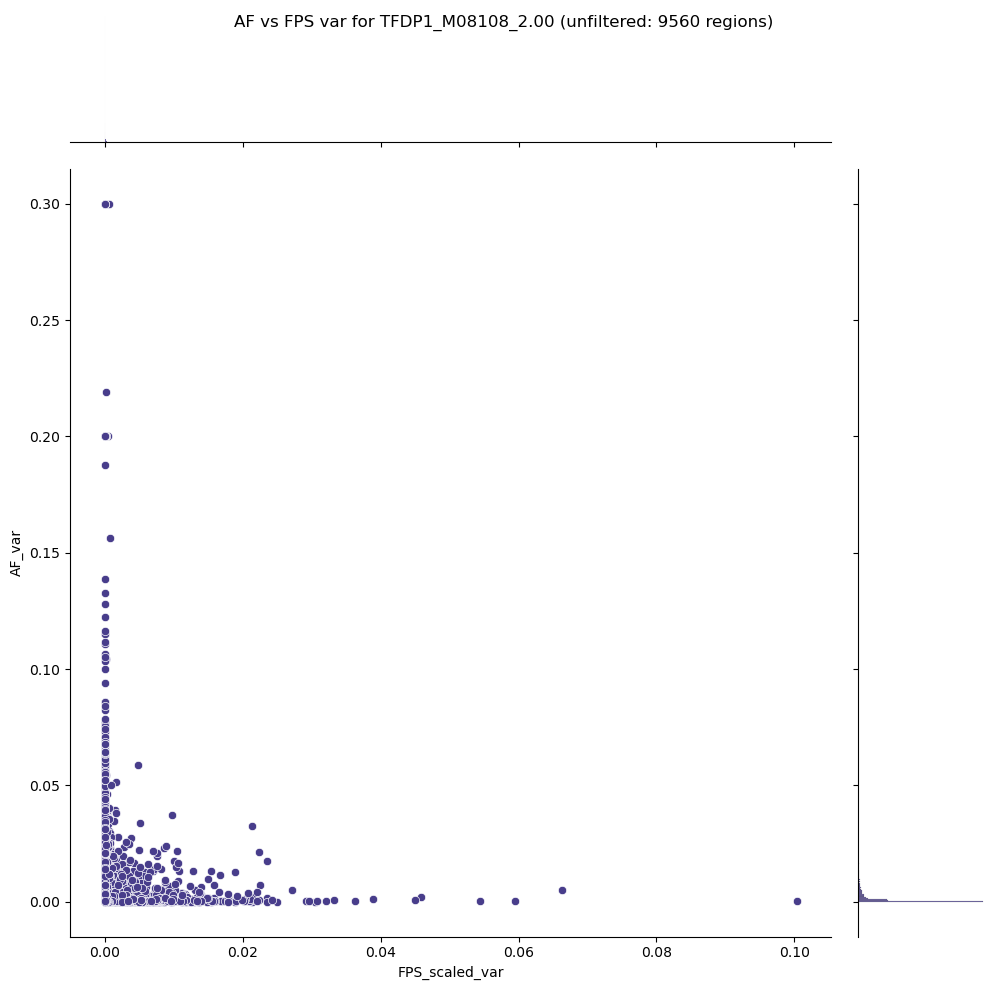

In [26]:
# plot the jointplot
g = sns.jointplot(data=afps_stats_ms_var, x="FPS_scaled_var", y="AF_var", height=10, ratio=5, color='darkslateblue' )
g.fig.suptitle(f'AF vs FPS var for {motif_id} (unfiltered: {len(afps_stats_ms_var)} regions)')
plt.show()

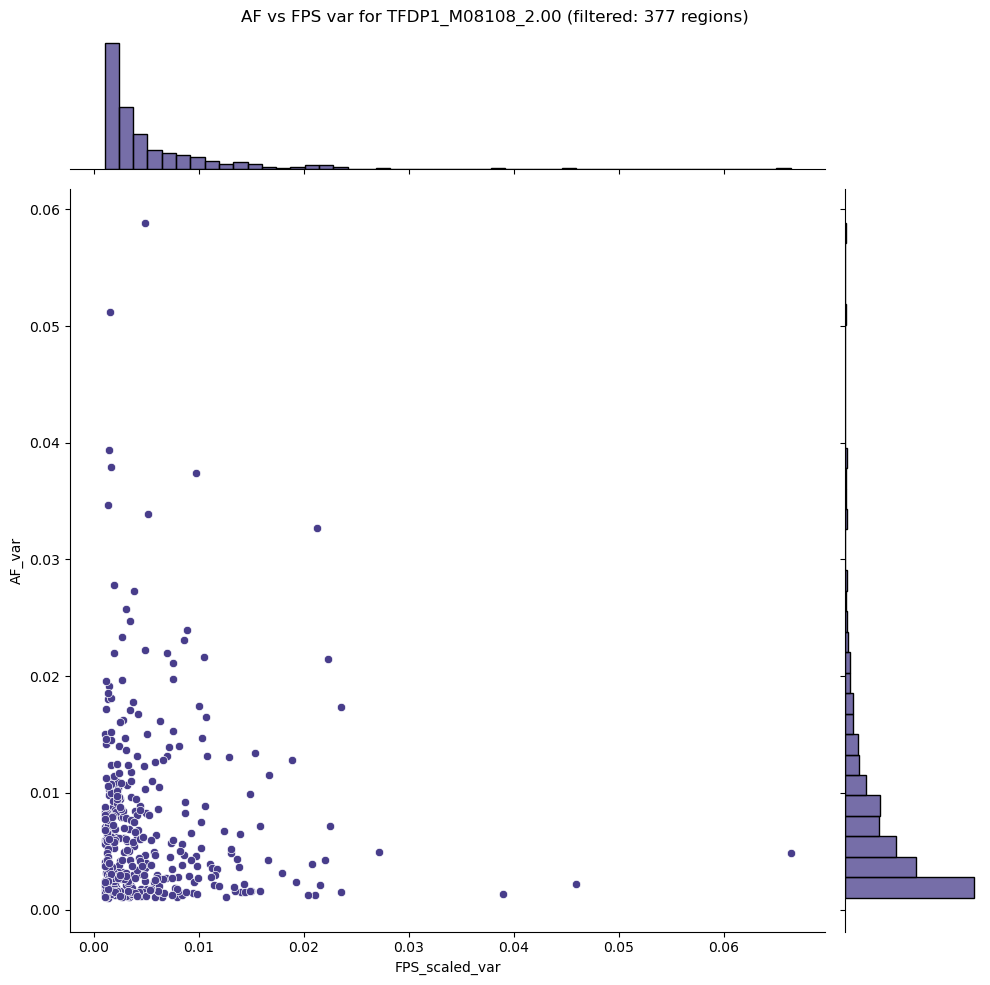

In [28]:
# plot the jointplot
g = sns.jointplot(data=test_df, x="FPS_scaled_var", y="AF_var", height=10, ratio=5, color='darkslateblue' )
g.fig.suptitle(f'AF vs FPS var for {motif_id} (filtered: {len(test_df)} regions)')
plt.tight_layout()
plt.show()

In [29]:
test_df.shape

(55, 2)

### Filtering Variant Sites (FPS)
From here on, it makes sense to filter out variant sites that has `FPS` value `== 0`. This means that the raw FPS values across subtypes are zero, i.e. there is no evidence of footprinting at all at these sites despite a TFBS matching a motif being present (assigned by TOBIAS).

In [29]:
afps_stats_mergesorted

,region_id,sample_id,AF,FPS,FPS_scaled,FPS_var,FPS_scaled_var,AF_var
0,chr1:191257-191268,2GAMBDQ_norm,0.000000,0.0,0.0,0.0,0.0,0.000139
1,chr1:191257-191268,98JKPD8_lumA,0.000000,0.0,0.0,0.0,0.0,0.000139
2,chr1:191257-191268,ANAB5F7_basal,0.000000,0.0,0.0,0.0,0.0,0.000139
3,chr1:191257-191268,PU24GB8_lumB,0.026316,0.0,0.0,0.0,0.0,0.000139
4,chr1:191257-191268,S6R691V_her2,0.000000,0.0,0.0,0.0,0.0,0.000139
...,...,...,...,...,...,...,...,...
47795,chrY:11108019-11108030,2GAMBDQ_norm,0.437500,0.0,0.0,0.0,0.0,0.020715
47796,chrY:11108019-11108030,98JKPD8_lumA,0.100000,0.0,0.0,0.0,0.0,0.020715
47797,chrY:11108019-11108030,ANAB5F7_basal,0.382353,0.0,0.0,0.0,0.0,0.020715
47798,chrY:11108019-11108030,PU24GB8_lumB,0.264706,0.0,0.0,0.0,0.0,0.020715


In [30]:
# filter out unique region_id rows that have fps == 0 across the sample_ids
# group by 'region_id' first 
merged_filt = afps_stats_mergesorted.groupby('region_id').filter(lambda x: x['FPS'].sum() > 0)
merged_filt

,region_id,sample_id,AF,FPS,FPS_scaled,FPS_var,FPS_scaled_var,AF_var
5,chr1:818021-818032,2GAMBDQ_norm,0.875000,0.03443,0.009147,0.000068,0.000010,0.001576
6,chr1:818021-818032,98JKPD8_lumA,0.900000,0.02966,0.007823,0.000068,0.000010,0.001576
7,chr1:818021-818032,ANAB5F7_basal,0.812500,0.04399,0.011176,0.000068,0.000010,0.001576
8,chr1:818021-818032,PU24GB8_lumB,0.833333,0.03470,0.009443,0.000068,0.000010,0.001576
9,chr1:818021-818032,S6R691V_her2,0.900000,0.02131,0.002785,0.000068,0.000010,0.001576
...,...,...,...,...,...,...,...,...
47790,chrX:155641610-155641621,2GAMBDQ_norm,0.000000,0.01740,0.004623,0.000004,0.000001,0.000173
47791,chrX:155641610-155641621,98JKPD8_lumA,0.000000,0.01249,0.003294,0.000004,0.000001,0.000173
47792,chrX:155641610-155641621,ANAB5F7_basal,0.000000,0.01243,0.003158,0.000004,0.000001,0.000173
47793,chrX:155641610-155641621,PU24GB8_lumB,0.029412,0.01492,0.004060,0.000004,0.000001,0.000173


In [32]:
# merged_filt[(merged_filt['FPS_cv'].isna() | merged_filt['FPS_qcd'].isna())]

We are not interested in footprints that carry no called variants so we can also filter out all rows with `AF == 0`, as these represent sites that are not variant at all. The only reason they are in the matrix is because during the raw data merging, these sites are retained when there is at least one subtype that has a non-zero AF value at that site, or non-zero FPS values at that site.

However, we would still be interested in sites with AF values not equal zero at least in one of the subtypes, so we do not want to filter out sites that have at least one non-zero AF value.

In [31]:
# filter out unique region_id rows that have AF == 0 in all subtypes (sample_id grouping)
# this has to be per group, so we need to groupby first
merged_filt_nozero = merged_filt.groupby('region_id').filter(lambda x: (x['AF'] != 0).any())
merged_filt_nozero

,region_id,sample_id,AF,FPS,FPS_scaled,FPS_var,FPS_scaled_var,AF_var
5,chr1:818021-818032,2GAMBDQ_norm,0.875000,0.03443,0.009147,0.000068,0.000010,0.001576
6,chr1:818021-818032,98JKPD8_lumA,0.900000,0.02966,0.007823,0.000068,0.000010,0.001576
7,chr1:818021-818032,ANAB5F7_basal,0.812500,0.04399,0.011176,0.000068,0.000010,0.001576
8,chr1:818021-818032,PU24GB8_lumB,0.833333,0.03470,0.009443,0.000068,0.000010,0.001576
9,chr1:818021-818032,S6R691V_her2,0.900000,0.02131,0.002785,0.000068,0.000010,0.001576
...,...,...,...,...,...,...,...,...
47790,chrX:155641610-155641621,2GAMBDQ_norm,0.000000,0.01740,0.004623,0.000004,0.000001,0.000173
47791,chrX:155641610-155641621,98JKPD8_lumA,0.000000,0.01249,0.003294,0.000004,0.000001,0.000173
47792,chrX:155641610-155641621,ANAB5F7_basal,0.000000,0.01243,0.003158,0.000004,0.000001,0.000173
47793,chrX:155641610-155641621,PU24GB8_lumB,0.029412,0.01492,0.004060,0.000004,0.000001,0.000173


Now we can select unique `region_id`s that have at least one AF value in the subtype group that is equal to 0 AND the max AF value in the subtype group is more than 0.5. This is because for sites that have a called variant in at least one subtype, we are only interested in them if the called variant has AF of more than 0.5.

We first group the df by the unique values of column `region_id`, then we retain only regions whose max value of column `AF` per unique site is more than 0.5.

In [32]:
# for each unique region_id, find those that has AF == 0 in at least one subtype
# this has to be per group, so we need to groupby first
region_af_zero = merged_filt_nozero.groupby('region_id').filter(lambda x: (x['AF'] == 0).any())
region_af_zero

,region_id,sample_id,AF,FPS,FPS_scaled,FPS_var,FPS_scaled_var,AF_var
10,chr1:818780-818791,2GAMBDQ_norm,0.000000,0.03391,0.009009,0.000020,0.000005,0.002113
11,chr1:818780-818791,98JKPD8_lumA,0.125000,0.02572,0.006783,0.000020,0.000005,0.002113
12,chr1:818780-818791,ANAB5F7_basal,0.033333,0.02376,0.006036,0.000020,0.000005,0.002113
13,chr1:818780-818791,PU24GB8_lumB,0.055556,0.02814,0.007658,0.000020,0.000005,0.002113
14,chr1:818780-818791,S6R691V_her2,0.062500,0.02271,0.002968,0.000020,0.000005,0.002113
...,...,...,...,...,...,...,...,...
47790,chrX:155641610-155641621,2GAMBDQ_norm,0.000000,0.01740,0.004623,0.000004,0.000001,0.000173
47791,chrX:155641610-155641621,98JKPD8_lumA,0.000000,0.01249,0.003294,0.000004,0.000001,0.000173
47792,chrX:155641610-155641621,ANAB5F7_basal,0.000000,0.01243,0.003158,0.000004,0.000001,0.000173
47793,chrX:155641610-155641621,PU24GB8_lumB,0.029412,0.01492,0.004060,0.000004,0.000001,0.000173


In [33]:
# then find the max AF value for each region_id and add to a new column called 'max_AF'
df = region_af_zero.groupby('region_id').agg({'AF': 'max'}).rename(columns={'AF': 'max_AF'}).reset_index()
max_af = df.reindex(index=index_natsorted(df['region_id']))
max_af

,region_id,max_AF
3097,chr1:818780-818791,0.125000
3126,chr1:960570-960581,0.041667
3128,chr1:977174-977185,1.000000
3129,chr1:977206-977217,1.000000
3130,chr1:977394-977405,1.000000
...,...,...
6259,chrX:153642534-153642545,0.062500
6260,chrX:153934861-153934872,0.062500
6261,chrX:154444629-154444640,0.125000
6262,chrX:155010397-155010408,0.392857


In [34]:
# now return a boolean mask for regions that have max_AF <= 0.5
mask = max_af['max_AF'] <= 0.5
# sum here counts the number of True values in the mask
mask.sum()

6293

Now we can filter the merged dataframes such that rows that have `region_id` in the Boolean-masked `max_af` <= 0.5 dataframe will be discarded (so we retain only `region_id` rows that have `max_af` > 0.5).

In [35]:
# this is done by subsetting the long dataframe with an expression that makes use of isin() method on the max_af dataframe masked by the boolean series, and then taking the inverse of the expression using ~
merged_filt_nolowaf = merged_filt_nozero[~(merged_filt_nozero['region_id'].isin(max_af[mask]['region_id']))]
merged_filt_nolowaf

,region_id,sample_id,AF,FPS,FPS_scaled,FPS_var,FPS_scaled_var,AF_var
5,chr1:818021-818032,2GAMBDQ_norm,0.875000,0.03443,0.009147,0.000068,0.000010,0.001576
6,chr1:818021-818032,98JKPD8_lumA,0.900000,0.02966,0.007823,0.000068,0.000010,0.001576
7,chr1:818021-818032,ANAB5F7_basal,0.812500,0.04399,0.011176,0.000068,0.000010,0.001576
8,chr1:818021-818032,PU24GB8_lumB,0.833333,0.03470,0.009443,0.000068,0.000010,0.001576
9,chr1:818021-818032,S6R691V_her2,0.900000,0.02131,0.002785,0.000068,0.000010,0.001576
...,...,...,...,...,...,...,...,...
47755,chrX:153495405-153495416,2GAMBDQ_norm,1.000000,0.02562,0.006806,0.000059,0.000003,0.002347
47756,chrX:153495405-153495416,98JKPD8_lumA,1.000000,0.01647,0.004344,0.000059,0.000003,0.002347
47757,chrX:153495405-153495416,ANAB5F7_basal,0.882353,0.03213,0.008163,0.000059,0.000003,0.002347
47758,chrX:153495405-153495416,PU24GB8_lumB,0.973684,0.01603,0.004362,0.000059,0.000003,0.002347


In [36]:
# now filter out the rows with AF == 0 on the merge_filt dataframe
merged_filt_nozeroaf = merged_filt_nozero[~(merged_filt_nozero['region_id'].isin(max_af['region_id']))]
merged_filt_nozeroaf

,region_id,sample_id,AF,FPS,FPS_scaled,FPS_var,FPS_scaled_var,AF_var
5,chr1:818021-818032,2GAMBDQ_norm,0.875000,0.03443,0.009147,0.000068,0.000010,0.001576
6,chr1:818021-818032,98JKPD8_lumA,0.900000,0.02966,0.007823,0.000068,0.000010,0.001576
7,chr1:818021-818032,ANAB5F7_basal,0.812500,0.04399,0.011176,0.000068,0.000010,0.001576
8,chr1:818021-818032,PU24GB8_lumB,0.833333,0.03470,0.009443,0.000068,0.000010,0.001576
9,chr1:818021-818032,S6R691V_her2,0.900000,0.02131,0.002785,0.000068,0.000010,0.001576
...,...,...,...,...,...,...,...,...
47755,chrX:153495405-153495416,2GAMBDQ_norm,1.000000,0.02562,0.006806,0.000059,0.000003,0.002347
47756,chrX:153495405-153495416,98JKPD8_lumA,1.000000,0.01647,0.004344,0.000059,0.000003,0.002347
47757,chrX:153495405-153495416,ANAB5F7_basal,0.882353,0.03213,0.008163,0.000059,0.000003,0.002347
47758,chrX:153495405-153495416,PU24GB8_lumB,0.973684,0.01603,0.004362,0.000059,0.000003,0.002347


In [37]:
# save the unique region_id rows where AF == 0 in at least one subtype to file just in case
atleast_one_zero_af = merged_filt_nozero[merged_filt_nozero['region_id'].isin(max_af['region_id'])]
atleast_one_zero_af

,region_id,sample_id,AF,FPS,FPS_scaled,FPS_var,FPS_scaled_var,AF_var
10,chr1:818780-818791,2GAMBDQ_norm,0.000000,0.03391,0.009009,0.000020,0.000005,0.002113
11,chr1:818780-818791,98JKPD8_lumA,0.125000,0.02572,0.006783,0.000020,0.000005,0.002113
12,chr1:818780-818791,ANAB5F7_basal,0.033333,0.02376,0.006036,0.000020,0.000005,0.002113
13,chr1:818780-818791,PU24GB8_lumB,0.055556,0.02814,0.007658,0.000020,0.000005,0.002113
14,chr1:818780-818791,S6R691V_her2,0.062500,0.02271,0.002968,0.000020,0.000005,0.002113
...,...,...,...,...,...,...,...,...
47790,chrX:155641610-155641621,2GAMBDQ_norm,0.000000,0.01740,0.004623,0.000004,0.000001,0.000173
47791,chrX:155641610-155641621,98JKPD8_lumA,0.000000,0.01249,0.003294,0.000004,0.000001,0.000173
47792,chrX:155641610-155641621,ANAB5F7_basal,0.000000,0.01243,0.003158,0.000004,0.000001,0.000173
47793,chrX:155641610-155641621,PU24GB8_lumB,0.029412,0.01492,0.004060,0.000004,0.000001,0.000173


### Filtering Variant Sites (AF)
Now we can calculate the median for AF values to append to the merged, filtered longform dataframe.

In [45]:
merged_filt

,region_id,sample_id,AF,FPS,FPS_scaled,FPS_var,FPS_scaled_var,AF_var
5,chr1:818021-818032,2GAMBDQ_norm,0.875000,0.03443,0.009147,0.000068,0.000010,0.001576
6,chr1:818021-818032,98JKPD8_lumA,0.900000,0.02966,0.007823,0.000068,0.000010,0.001576
7,chr1:818021-818032,ANAB5F7_basal,0.812500,0.04399,0.011176,0.000068,0.000010,0.001576
8,chr1:818021-818032,PU24GB8_lumB,0.833333,0.03470,0.009443,0.000068,0.000010,0.001576
9,chr1:818021-818032,S6R691V_her2,0.900000,0.02131,0.002785,0.000068,0.000010,0.001576
...,...,...,...,...,...,...,...,...
47790,chrX:155641610-155641621,2GAMBDQ_norm,0.000000,0.01740,0.004623,0.000004,0.000001,0.000173
47791,chrX:155641610-155641621,98JKPD8_lumA,0.000000,0.01249,0.003294,0.000004,0.000001,0.000173
47792,chrX:155641610-155641621,ANAB5F7_basal,0.000000,0.01243,0.003158,0.000004,0.000001,0.000173
47793,chrX:155641610-155641621,PU24GB8_lumB,0.029412,0.01492,0.004060,0.000004,0.000001,0.000173


In [38]:
# copy the filtered dataframe
mf_df = merged_filt_nozeroaf.copy()
mf_df = mf_df.reset_index(drop=True)
# # calculate AF mean per region_id
# mf_df['AF_mean'] = mf_df.groupby('region_id')['AF'].transform('mean')
mf_df

,region_id,sample_id,AF,FPS,FPS_scaled,FPS_var,FPS_scaled_var,AF_var
0,chr1:818021-818032,2GAMBDQ_norm,0.875000,0.03443,0.009147,0.000068,0.000010,0.001576
1,chr1:818021-818032,98JKPD8_lumA,0.900000,0.02966,0.007823,0.000068,0.000010,0.001576
2,chr1:818021-818032,ANAB5F7_basal,0.812500,0.04399,0.011176,0.000068,0.000010,0.001576
3,chr1:818021-818032,PU24GB8_lumB,0.833333,0.03470,0.009443,0.000068,0.000010,0.001576
4,chr1:818021-818032,S6R691V_her2,0.900000,0.02131,0.002785,0.000068,0.000010,0.001576
...,...,...,...,...,...,...,...,...
11840,chrX:153495405-153495416,2GAMBDQ_norm,1.000000,0.02562,0.006806,0.000059,0.000003,0.002347
11841,chrX:153495405-153495416,98JKPD8_lumA,1.000000,0.01647,0.004344,0.000059,0.000003,0.002347
11842,chrX:153495405-153495416,ANAB5F7_basal,0.882353,0.03213,0.008163,0.000059,0.000003,0.002347
11843,chrX:153495405-153495416,PU24GB8_lumB,0.973684,0.01603,0.004362,0.000059,0.000003,0.002347


Let's visualize the AF distribution for each variant site.

In [39]:
dutchfield = ["#e60049", "#0bb4ff", "#87bc45", "#ef9b20", "#b33dc6"]

springpastel = ["#fd7f6f", "#7eb0d5", "#b2e061", "#bd7ebe", "#ffb55a"] 

In [42]:
# plot violin plot for AF on the filtered dataframe
# plt.figure(figsize=(10, 10), dpi=300)
# sns.violinplot(x='region_id', y='AF', data=mf_df, color='lightgray', inner='quartile', linecolor='black', linewidth=0.5)
# plt.xticks(rotation=90, fontsize=2)
# sns.stripplot(x='region_id', y='AF', data=mf_df, hue='sample_id', size=2.5, jitter=True, palette='deep')


# # plot legend outside of the plot
# plt.legend(bbox_to_anchor=(1.01, 1),borderaxespad=0, markerscale=2, fontsize=10)
# plt.xlabel(f'{motif_id} TF binding sites with allelic variants', fontsize=8)
# plt.ylabel('Allele frequency (AF)', fontsize=8)
# plt.show()

~~Plotting the whole data makes the plot look very busy. We can split the data into 2 groups: 'high AF' and 'low AF'. We will define 'high AF' as `AF_median` > 0.5, and 'low AF' as `AF_median` <= 0.5.~~ 

Let's not just filter by `AF_median`, but instead filter for `region_id` in which none of the AF values are < 0.5.

In [40]:
# to ensure that each unique region_id is retained as a group of subtype rows, we need to filter after grouping per region_id
# high_af = mf_df.groupby('region_id').filter(lambda x: (x['AF_median'] > 0.5).any())
high_af = mf_df.groupby('region_id').filter(lambda x: (x['AF'] > 0.5).all())
high_af

,region_id,sample_id,AF,FPS,FPS_scaled,FPS_var,FPS_scaled_var,AF_var
0,chr1:818021-818032,2GAMBDQ_norm,0.875000,0.03443,0.009147,0.000068,0.000010,0.001576
1,chr1:818021-818032,98JKPD8_lumA,0.900000,0.02966,0.007823,0.000068,0.000010,0.001576
2,chr1:818021-818032,ANAB5F7_basal,0.812500,0.04399,0.011176,0.000068,0.000010,0.001576
3,chr1:818021-818032,PU24GB8_lumB,0.833333,0.03470,0.009443,0.000068,0.000010,0.001576
4,chr1:818021-818032,S6R691V_her2,0.900000,0.02131,0.002785,0.000068,0.000010,0.001576
...,...,...,...,...,...,...,...,...
11840,chrX:153495405-153495416,2GAMBDQ_norm,1.000000,0.02562,0.006806,0.000059,0.000003,0.002347
11841,chrX:153495405-153495416,98JKPD8_lumA,1.000000,0.01647,0.004344,0.000059,0.000003,0.002347
11842,chrX:153495405-153495416,ANAB5F7_basal,0.882353,0.03213,0.008163,0.000059,0.000003,0.002347
11843,chrX:153495405-153495416,PU24GB8_lumB,0.973684,0.01603,0.004362,0.000059,0.000003,0.002347


In [41]:
# low_af = mf_df.groupby('region_id').filter(lambda x: (x['AF_median'] <= 0.5).any())
low_af = mf_df.groupby('region_id').filter(lambda x: (x['AF'] <= 0.5).all())
low_af

,region_id,sample_id,AF,FPS,FPS_scaled,FPS_var,FPS_scaled_var,AF_var
35,chr1:986626-986637,2GAMBDQ_norm,0.142857,0.04807,0.012771,0.000305,0.000032,0.002325
36,chr1:986626-986637,98JKPD8_lumA,0.166667,0.06207,0.016370,0.000305,0.000032,0.002325
37,chr1:986626-986637,ANAB5F7_basal,0.156250,0.01957,0.004972,0.000305,0.000032,0.002325
38,chr1:986626-986637,PU24GB8_lumB,0.176471,0.05148,0.014009,0.000305,0.000032,0.002325
39,chr1:986626-986637,S6R691V_her2,0.264706,0.02828,0.003696,0.000305,0.000032,0.002325
...,...,...,...,...,...,...,...,...
11800,chrX:107655092-107655103,2GAMBDQ_norm,0.125000,0.03608,0.009585,0.000099,0.000011,0.003296
11801,chrX:107655092-107655103,98JKPD8_lumA,0.125000,0.05553,0.014646,0.000099,0.000011,0.003296
11802,chrX:107655092-107655103,ANAB5F7_basal,0.250000,0.05358,0.013613,0.000099,0.000011,0.003296
11803,chrX:107655092-107655103,PU24GB8_lumB,0.131579,0.03495,0.009511,0.000099,0.000011,0.003296


Alternatively, let's filter for `region_id` in which the max AF value is > 0.5.

In [46]:
# filter out unique region_id rows whose max AF is <= 0.5
merged_filt_nolowaf

,region_id,sample_id,AF,FPS,FPS_scaled,FPS_var,FPS_scaled_var,AF_var
5,chr1:818021-818032,2GAMBDQ_norm,0.875000,0.03443,0.009147,0.000068,0.000010,0.001576
6,chr1:818021-818032,98JKPD8_lumA,0.900000,0.02966,0.007823,0.000068,0.000010,0.001576
7,chr1:818021-818032,ANAB5F7_basal,0.812500,0.04399,0.011176,0.000068,0.000010,0.001576
8,chr1:818021-818032,PU24GB8_lumB,0.833333,0.03470,0.009443,0.000068,0.000010,0.001576
9,chr1:818021-818032,S6R691V_her2,0.900000,0.02131,0.002785,0.000068,0.000010,0.001576
...,...,...,...,...,...,...,...,...
47755,chrX:153495405-153495416,2GAMBDQ_norm,1.000000,0.02562,0.006806,0.000059,0.000003,0.002347
47756,chrX:153495405-153495416,98JKPD8_lumA,1.000000,0.01647,0.004344,0.000059,0.000003,0.002347
47757,chrX:153495405-153495416,ANAB5F7_basal,0.882353,0.03213,0.008163,0.000059,0.000003,0.002347
47758,chrX:153495405-153495416,PU24GB8_lumB,0.973684,0.01603,0.004362,0.000059,0.000003,0.002347


<Axes: xlabel='AF', ylabel='FPS_scaled'>

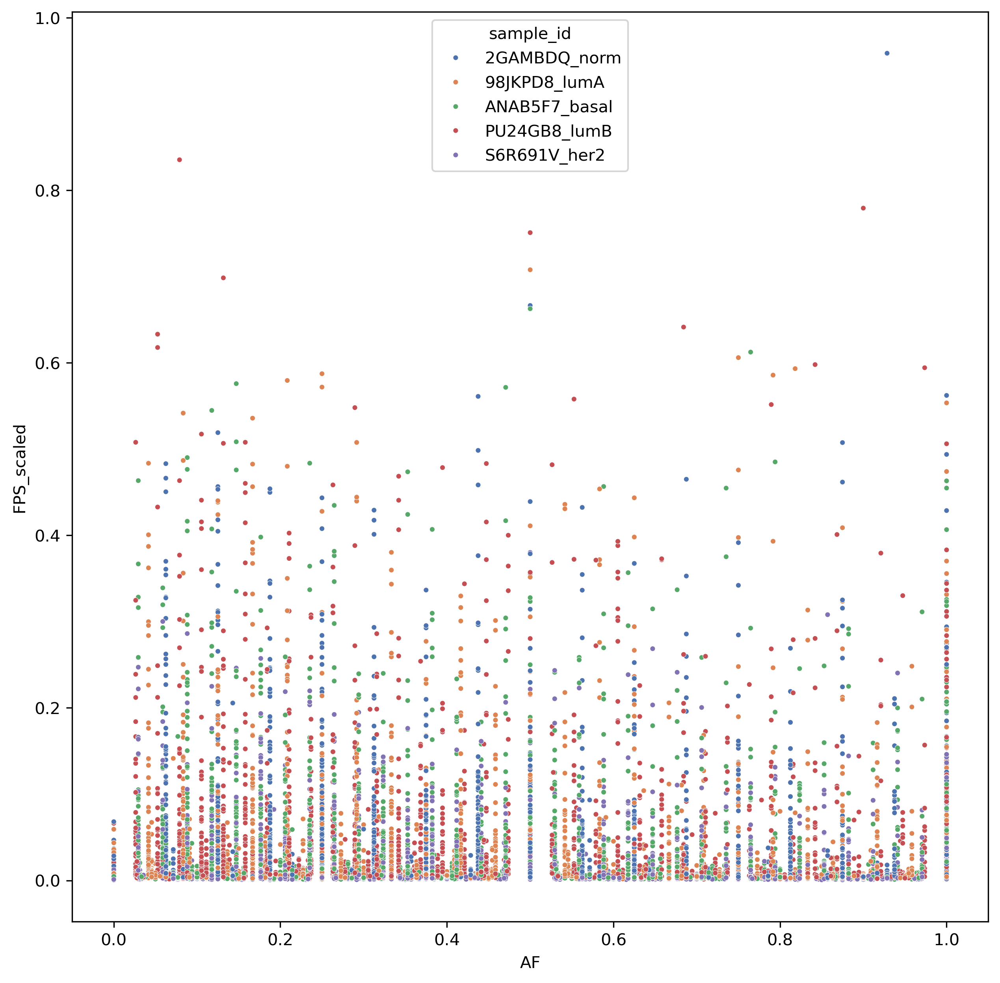

In [88]:
# plot scatter plot for AF vs FPS on the filtered dataframe hued by sample_id
plt.figure(figsize=(10, 10), dpi=300)
sns.scatterplot(data=merged_filt_nolowaf, x='AF', y='FPS_scaled', hue='sample_id', palette='deep', s=10)

In [89]:
# check correlation between AF and FPS_scaled
merged_filt_nolowaf[['AF', 'FPS_scaled']].corr()

,AF,FPS_scaled
AF,1.000000,0.003247
FPS_scaled,0.003247,1.000000


In [90]:
# now check for correlation between AF and FPS_scaled, but this time, grouped by sample_id
merged_filt_nolowaf.groupby('sample_id')[['AF', 'FPS_scaled']].corr()

AF  FPS_scaled
sample_id                                     
2GAMBDQ_norm  AF          1.000000    0.000427
              FPS_scaled  0.000427    1.000000
98JKPD8_lumA  AF          1.000000    0.006210
              FPS_scaled  0.006210    1.000000
ANAB5F7_basal AF          1.000000   -0.004762
              FPS_scaled -0.004762    1.000000
PU24GB8_lumB  AF          1.000000    0.012110
              FPS_scaled  0.012110    1.000000
S6R691V_her2  AF          1.000000   -0.002760
              FPS_scaled -0.002760    1.000000

/Users/sufyazi/Applications/bin/miniforge3/envs/quarto-docs/lib/python3.12/site-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/Users/sufyazi/Applications/bin/miniforge3/envs/quarto-docs/lib/python3.12/site-packages/seaborn/_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)


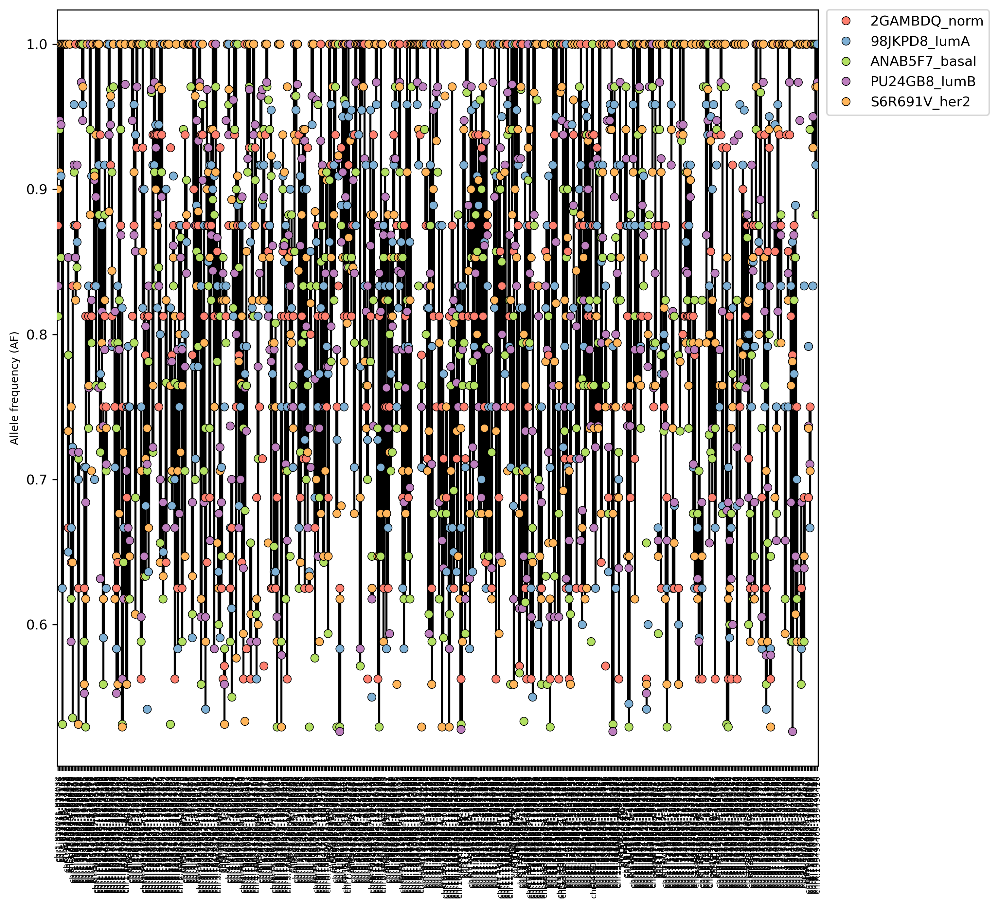

In [42]:
fig_tuple = plt.subplots(figsize=(10, 10), dpi=300, num=1, clear=True)
fig, ax = fig_tuple
# plot violin plot for high AF set
sns.boxplot(x='region_id', y='AF', data=high_af, color='lightgray', linecolor='black', linewidth=1.5, showfliers=False, ax=ax)
plt.xticks(rotation=90, fontsize=6)
sns.stripplot(x='region_id', y='AF', data=high_af, hue='sample_id', size=6, jitter=True, palette=springpastel, linewidth=0.5, edgecolor='black', ax=ax)
# plot legend outside of the plot
plt.legend(bbox_to_anchor=(1.225, 1),borderaxespad=0, markerscale=1, fontsize=10)
plt.xlabel('')
plt.ylabel('Allele frequency (AF)', fontsize=8)
plt.show()


In [46]:
# plot violin plot for low AF set
# plt.figure(figsize=(10, 10), dpi=300)
# sns.violinplot(x='region_id', y='AF', data=low_af, color='lightgray', inner='quartile', linecolor='black', linewidth=0.5)
# plt.xticks(rotation=90, fontsize=2)
# sns.stripplot(x='region_id', y='AF', data=low_af, hue='sample_id', size=2.5, jitter=True, palette='deep')


# # plot legend outside of the plot
# plt.legend(bbox_to_anchor=(1.01, 1),borderaxespad=0, markerscale=2, fontsize=10)
# plt.xlabel(f'{motif_id} TF binding sites with allelic variants (median AF <= 0.5)', fontsize=8)
# plt.ylabel('Allele frequency (AF)', fontsize=8)
# plt.show()

While we are at it, let's plot the regions where there was at least one subtype with AF value == 0, which is filtered and saved into a file above.

/Users/sufyazi/Applications/bin/miniforge3/envs/quarto-docs/lib/python3.12/site-packages/seaborn/_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)


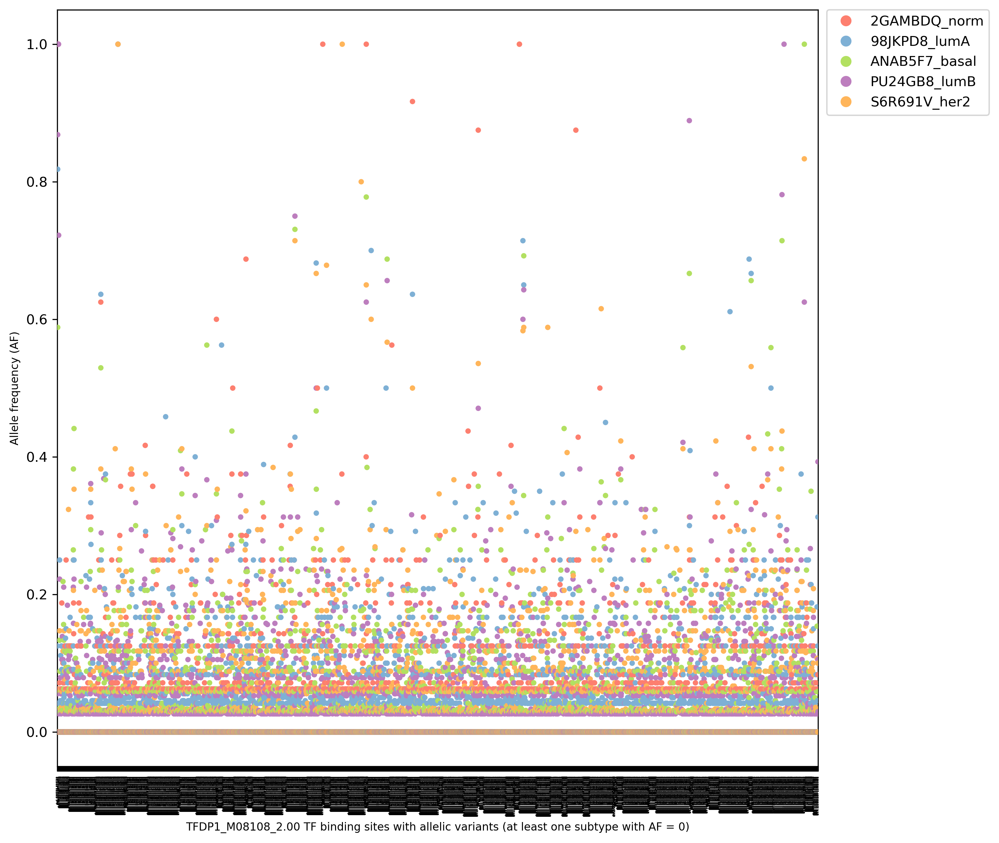

In [43]:
# plot violin plot for sites with at least one subtype with AF == 0
plt.figure(figsize=(10, 10), dpi=300)
# sns.boxplot(x='region_id', y='AF', data=atleast_one_zero_af, color='gainsboro', linecolor='black', linewidth=1.5, showfliers=False)
plt.xticks(rotation=90, fontsize=2)
sns.stripplot(x='region_id', y='AF', data=atleast_one_zero_af, hue='sample_id', size=4, jitter=True, palette=springpastel)


# plot legend outside of the plot
plt.legend(bbox_to_anchor=(1.225, 1),borderaxespad=0, markerscale=2, fontsize=10)
plt.xlabel(f'{motif_id} TF binding sites with allelic variants (at least one subtype with AF = 0)', fontsize=8)
plt.ylabel('Allele frequency (AF)', fontsize=8)

plt.show()

No clear pattern of enrichment of a specific subtype with high AF compared to the rest can be seen. We can use the subset of these to plot the distribution of the associated FPS values (unscaled). 

In [48]:
# fig, ax = plt.subplots(2, 1, figsize=(10, 10), dpi=300, num=1, clear=True)
# sns.boxplot(x='region_id', y='AF', data=high_af, color='lightgray', linecolor='black', linewidth=1.5, showfliers=False)
# plt.xticks(rotation=90, fontsize=6)
# sns.stripplot(x='region_id', y='AF', data=high_af, hue='sample_id', size=6, jitter=True, palette=springpastel, linewidth=0.5, edgecolor='black')
# # plot legend outside of the plot
# plt.legend(bbox_to_anchor=(1.225, 1),borderaxespad=0, markerscale=1, fontsize=10)
# plt.xlabel('')
# plt.ylabel('Allele frequency (AF)', fontsize=8)

# sns.boxplot(x='region_id', y='AF', data=high_af, color='lightgray', linecolor='black', linewidth=1.5, showfliers=False, ax=ax[0])
# ax[0].tick_params(axis='x', rotation=90, labelsize=6)
# sns.stripplot(x='region_id', y='AF', data=high_af, hue='sample_id', size=6, jitter=True, palette=springpastel, linewidth=0.5, edgecolor='black', ax=ax[0])
# # plot legend outside of the plot
# ax[0].legend(bbox_to_anchor=(1.225, 1),borderaxespad=0, markerscale=1, fontsize=10)
# ax[0].set_xlabel('')
# ax[0].set_ylabel('Allele frequency (AF)', fontsize=8)

# # then plot the scaled FPS values for these sites
# # plt.subplot(2, 1, 2)
# # sns.boxplot(x='region_id', y='FPS_scaled', data=high_af, color='white', linecolor='black', linewidth=1.5, showfliers=False)
# # plt.xticks(rotation=90, fontsize=6)
# # sns.stripplot(x='region_id', y='FPS_scaled', data=high_af, hue='sample_id', size=6, jitter=True, palette=springpastel, legend=False, linewidth=0.5, edgecolor='black')
# # plt.xlabel(f'{motif_id} TF binding sites with allelic variants (at least one subtype with AF = 0)', fontsize=10)
# # plt.ylabel(f'Footprint scores (FPS) (min-max scaled)', fontsize=8)
# # plt.subplots_adjust(hspace=0.6)
# # plt.show()

# sns.boxplot(x='region_id', y='FPS_scaled', data=high_af, color='white', linecolor='black', linewidth=1.5, showfliers=False, ax=ax[1])
# ax[1].tick_params(axis='x', rotation=90, labelsize=6)
# sns.stripplot(x='region_id', y='FPS_scaled', data=high_af, hue='sample_id', size=6, jitter=True, palette=springpastel, legend=False, linewidth=0.5, edgecolor='black', ax=ax[1])
# ax[1].set_xlabel(f'{motif_id} TF binding sites with allelic variants (at least one subtype with AF = 0)', fontsize=10)
# ax[1].set_ylabel(f'Footprint scores (FPS) (min-max scaled)', fontsize=8)

# plt.subplots_adjust(hspace=0.6)
# plt.show()

Some cancer subtypes appear to not have alternative alleles in certain sites but there is barely any pattern of enrichment in FPS values for any specific subtype.

What is the range of FPS variance in the subset dataframe?

In [44]:
high_af[['FPS_scaled_var', 'AF_var']].describe()

,FPS_scaled_var,AF_var
count,2.605000e+03,2605.000000
mean,8.176385e-04,0.005974
std,3.615034e-03,0.006504
min,1.315661e-07,0.000000
25%,3.033420e-06,0.000781
50%,1.756885e-05,0.004113
75%,2.659032e-04,0.009188
max,6.637156e-02,0.054492


Let's now apply thresholding onto the FPS scaled data to denoise the dataset even more. There are two strategies:

1. Thresholding by computing the outlier threshold using the IQR method on `FPS_scaled_var` values.This means we are only keeping regions that show extreme variance in FPS values across subtypes.
2. Thresholding by computing the mean of `FPS_scaled` values across subtypes and keeping only regions that have such value above the mean at least in one subtype. 

#### STRATEGY 1: IQR Method

In [49]:
# STRATEGY 1: subset high_af for sites with FPS_scaled_var > 75th percentile + 1.5 * IQR
iqr = high_af['FPS_scaled_var'].quantile(q=0.75) - high_af['FPS_scaled_var'].quantile(q=0.25)
high_af_fps_outliers = high_af[high_af['FPS_scaled_var'] > high_af['FPS_scaled_var'].quantile(q=0.75) + (1.5 * iqr)]
high_af_fps_outliers

,region_id,sample_id,AF,FPS,FPS_scaled,FPS_var,FPS_scaled_var,AF_var
5,chr1:977015-977026,2GAMBDQ_norm,1.000000,1.30155,0.345779,0.117365,0.013981,0.001510
6,chr1:977015-977026,98JKPD8_lumA,1.000000,1.10047,0.290240,0.117365,0.013981,0.001510
7,chr1:977015-977026,ANAB5F7_basal,0.941176,0.50514,0.128336,0.117365,0.013981,0.001510
8,chr1:977015-977026,PU24GB8_lumB,0.947368,1.21305,0.330112,0.117365,0.013981,0.001510
9,chr1:977015-977026,S6R691V_her2,0.911765,0.71035,0.092845,0.117365,0.013981,0.001510
...,...,...,...,...,...,...,...,...
11635,chr22:46738248-46738259,2GAMBDQ_norm,0.625000,0.26828,0.071273,0.006534,0.001087,0.002379
11636,chr22:46738248-46738259,98JKPD8_lumA,0.583333,0.41624,0.109780,0.006534,0.001087,0.002379
11637,chr22:46738248-46738259,ANAB5F7_basal,0.558824,0.47393,0.120407,0.006534,0.001087,0.002379
11638,chr22:46738248-46738259,PU24GB8_lumB,0.684211,0.44398,0.120822,0.006534,0.001087,0.002379


In [47]:
iqr = merged_filt_nolowaf['FPS_scaled_var'].quantile(q=0.75) - merged_filt_nolowaf['FPS_scaled_var'].quantile(q=0.25)
merged_filt_nolowaf_fps_outliers = merged_filt_nolowaf[merged_filt_nolowaf['FPS_scaled_var'] > merged_filt_nolowaf['FPS_scaled_var'].quantile(q=0.75) + (1.5 * iqr)]
merged_filt_nolowaf_fps_outliers

,region_id,sample_id,AF,FPS,FPS_scaled,FPS_var,FPS_scaled_var,AF_var
20,chr1:977015-977026,2GAMBDQ_norm,1.000000,1.30155,0.345779,0.117365,0.013981,0.00151
21,chr1:977015-977026,98JKPD8_lumA,1.000000,1.10047,0.290240,0.117365,0.013981,0.00151
22,chr1:977015-977026,ANAB5F7_basal,0.941176,0.50514,0.128336,0.117365,0.013981,0.00151
23,chr1:977015-977026,PU24GB8_lumB,0.947368,1.21305,0.330112,0.117365,0.013981,0.00151
24,chr1:977015-977026,S6R691V_her2,0.911765,0.71035,0.092845,0.117365,0.013981,0.00151
...,...,...,...,...,...,...,...,...
47620,chrX:119606547-119606558,2GAMBDQ_norm,0.750000,0.35600,0.094577,0.001173,0.000570,0.01172
47621,chrX:119606547-119606558,98JKPD8_lumA,0.666667,0.42368,0.111742,0.001173,0.000570,0.01172
47622,chrX:119606547-119606558,ANAB5F7_basal,0.941176,0.42560,0.108128,0.001173,0.000570,0.01172
47623,chrX:119606547-119606558,PU24GB8_lumB,0.710526,0.43062,0.117186,0.001173,0.000570,0.01172


In [51]:
# before discarding, grab all the regions where AF_var == 0; as we already filter out AF == 0, this would return regions where all subtypes have AF == 1, hence zero variance
# af_var_one = high_af_fps_outliers[high_af_fps_outliers['AF_var'] == 0]
# save to file
# af_var_one.to_csv(f'/home/msazizan/hyperspace/gatk-workflow/plotting/output-data/AF-FPS_regionsorted_full_longtable/{motif_id}_afps_longtable_raw_af_one_across_subtypes.tsv', sep='\t', index=False)

In [50]:
# and then discard sites if it has AF_var == 0 (i.e. all subtypes have AF == 1, as we already filter out raw AF == 0)
high_nzaf_outliers = high_af_fps_outliers[high_af_fps_outliers['AF_var'] != 0]
high_nzaf_outliers

,region_id,sample_id,AF,FPS,FPS_scaled,FPS_var,FPS_scaled_var,AF_var
5,chr1:977015-977026,2GAMBDQ_norm,1.000000,1.30155,0.345779,0.117365,0.013981,0.001510
6,chr1:977015-977026,98JKPD8_lumA,1.000000,1.10047,0.290240,0.117365,0.013981,0.001510
7,chr1:977015-977026,ANAB5F7_basal,0.941176,0.50514,0.128336,0.117365,0.013981,0.001510
8,chr1:977015-977026,PU24GB8_lumB,0.947368,1.21305,0.330112,0.117365,0.013981,0.001510
9,chr1:977015-977026,S6R691V_her2,0.911765,0.71035,0.092845,0.117365,0.013981,0.001510
...,...,...,...,...,...,...,...,...
11635,chr22:46738248-46738259,2GAMBDQ_norm,0.625000,0.26828,0.071273,0.006534,0.001087,0.002379
11636,chr22:46738248-46738259,98JKPD8_lumA,0.583333,0.41624,0.109780,0.006534,0.001087,0.002379
11637,chr22:46738248-46738259,ANAB5F7_basal,0.558824,0.47393,0.120407,0.006534,0.001087,0.002379
11638,chr22:46738248-46738259,PU24GB8_lumB,0.684211,0.44398,0.120822,0.006534,0.001087,0.002379


In [51]:
nzaf_outliers = merged_filt_nolowaf_fps_outliers[merged_filt_nolowaf_fps_outliers['AF_var'] != 0]
nzaf_outliers

,region_id,sample_id,AF,FPS,FPS_scaled,FPS_var,FPS_scaled_var,AF_var
20,chr1:977015-977026,2GAMBDQ_norm,1.000000,1.30155,0.345779,0.117365,0.013981,0.00151
21,chr1:977015-977026,98JKPD8_lumA,1.000000,1.10047,0.290240,0.117365,0.013981,0.00151
22,chr1:977015-977026,ANAB5F7_basal,0.941176,0.50514,0.128336,0.117365,0.013981,0.00151
23,chr1:977015-977026,PU24GB8_lumB,0.947368,1.21305,0.330112,0.117365,0.013981,0.00151
24,chr1:977015-977026,S6R691V_her2,0.911765,0.71035,0.092845,0.117365,0.013981,0.00151
...,...,...,...,...,...,...,...,...
47620,chrX:119606547-119606558,2GAMBDQ_norm,0.750000,0.35600,0.094577,0.001173,0.000570,0.01172
47621,chrX:119606547-119606558,98JKPD8_lumA,0.666667,0.42368,0.111742,0.001173,0.000570,0.01172
47622,chrX:119606547-119606558,ANAB5F7_basal,0.941176,0.42560,0.108128,0.001173,0.000570,0.01172
47623,chrX:119606547-119606558,PU24GB8_lumB,0.710526,0.43062,0.117186,0.001173,0.000570,0.01172


/Users/sufyazi/Applications/bin/miniforge3/envs/quarto-docs/lib/python3.12/site-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/Users/sufyazi/Applications/bin/miniforge3/envs/quarto-docs/lib/python3.12/site-packages/seaborn/_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
/Users/sufyazi/Applications/bin/miniforge3/envs/quarto-docs/lib/python3.12/site-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/Users/sufyazi/Applications/bin/miniforge3/envs/quarto-docs/lib/python3.12/si

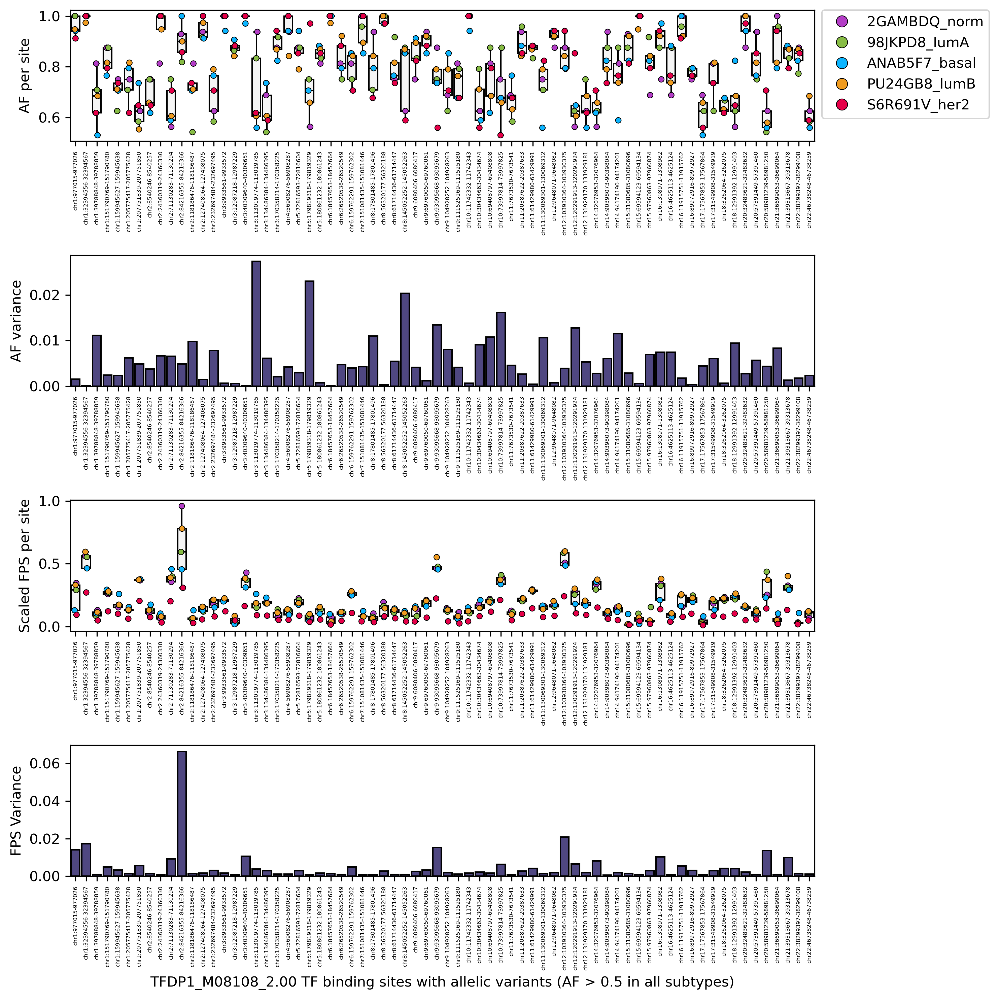

In [52]:
# create color dictionary
dutchfield_colordict = {'S6R691V_her2': "#e60049", 'ANAB5F7_basal': "#0bb4ff", '98JKPD8_lumA': "#87bc45", 'PU24GB8_lumB': "#ef9b20", '2GAMBDQ_norm': "#b33dc6"}
plt.figure(figsize=(10, 10), dpi=300)
# specify subplot
plt.subplot(4, 1, 1)
sns.boxplot(x='region_id', y='AF', data=high_nzaf_outliers, color='whitesmoke', linecolor='black', showfliers=False)
sns.stripplot(x='region_id', y='AF', data=high_nzaf_outliers, hue='sample_id', palette=dutchfield_colordict, size=4, jitter=True, linewidth=0.5, edgecolor='black')
plt.xticks(rotation=90, fontsize=4)
plt.xlabel('')
plt.ylabel('AF per site', fontsize=10)
# place legend outside of the plot
plt.legend(bbox_to_anchor=(1.01, 1),borderaxespad=0, markerscale=2, fontsize=10)

plt.subplot(4, 1, 2)
sns.barplot(x='region_id', y='AF_var', data=high_nzaf_outliers, color='darkslateblue', edgecolor='black')
plt.xticks(rotation=90, fontsize=4)
plt.xlabel('')
plt.ylabel('AF variance', fontsize=10)
  
plt.subplot(4, 1, 3)
sns.boxplot(x='region_id', y='FPS_scaled', data=high_nzaf_outliers, color='whitesmoke', linecolor='black', showfliers=False)
sns.stripplot(x='region_id', y='FPS_scaled', data=high_nzaf_outliers, hue='sample_id', palette=dutchfield_colordict, size=4, jitter=True, legend=False, linewidth=0.5, edgecolor='black')
plt.xticks(rotation=90, fontsize=4)
plt.xlabel('')
plt.ylabel('Scaled FPS per site', fontsize=10)

plt.subplot(4, 1, 4)
sns.barplot(x='region_id', y='FPS_scaled_var', data=high_nzaf_outliers, color='darkslateblue', edgecolor='black')
plt.xticks(rotation=90, fontsize=4)
plt.xlabel(f'{motif_id} TF binding sites with allelic variants (AF > 0.5 in all subtypes)', fontsize=10)
plt.ylabel('FPS Variance', fontsize=10)
plt.subplots_adjust(hspace=0.8)
plt.tight_layout()
plt.show()

/Users/sufyazi/Applications/bin/miniforge3/envs/quarto-docs/lib/python3.12/site-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/Users/sufyazi/Applications/bin/miniforge3/envs/quarto-docs/lib/python3.12/site-packages/seaborn/_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
/Users/sufyazi/Applications/bin/miniforge3/envs/quarto-docs/lib/python3.12/site-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/Users/sufyazi/Applications/bin/miniforge3/envs/quarto-docs/lib/python3.12/si

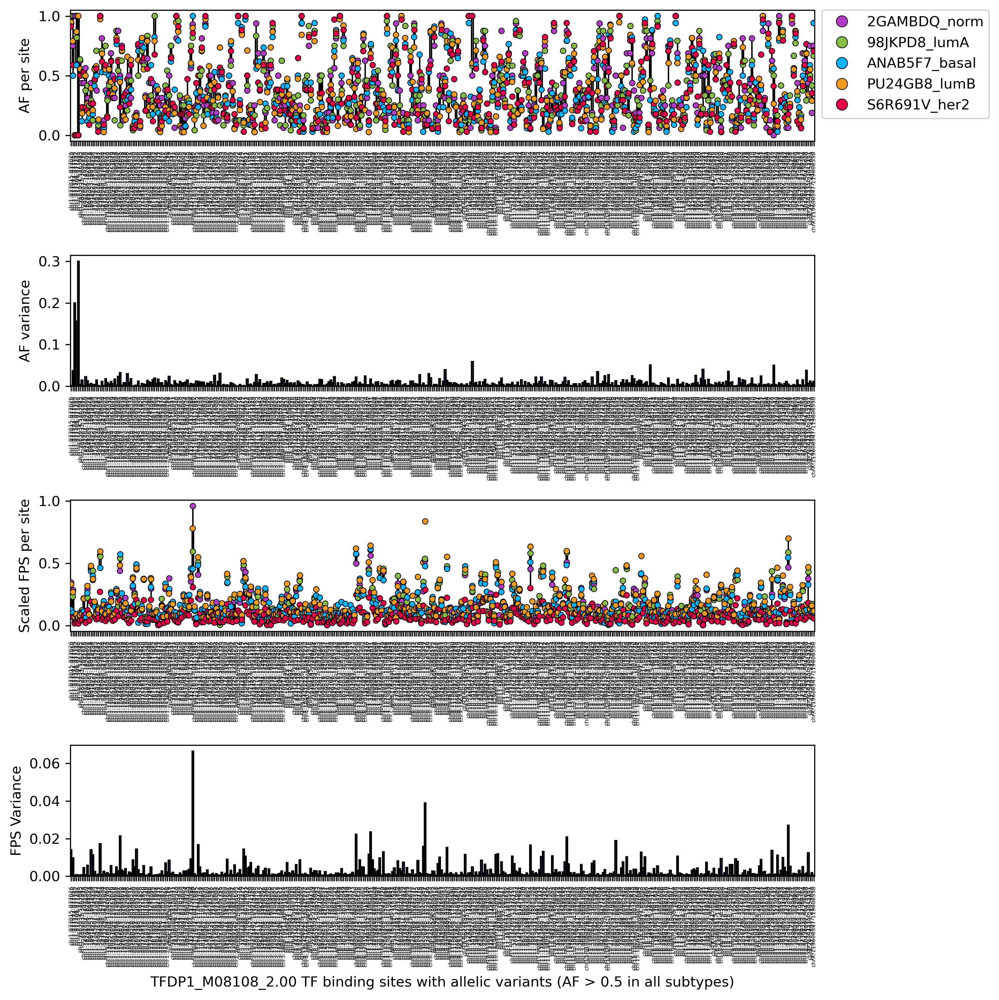

In [53]:
# create color dictionary
dutchfield_colordict = {'S6R691V_her2': "#e60049", 'ANAB5F7_basal': "#0bb4ff", '98JKPD8_lumA': "#87bc45", 'PU24GB8_lumB': "#ef9b20", '2GAMBDQ_norm': "#b33dc6"}
plt.figure(figsize=(10, 10), dpi=300)
# specify subplot
plt.subplot(4, 1, 1)
sns.boxplot(x='region_id', y='AF', data=nzaf_outliers, color='whitesmoke', linecolor='black', showfliers=False)
sns.stripplot(x='region_id', y='AF', data=nzaf_outliers, hue='sample_id', palette=dutchfield_colordict, size=4, jitter=True, linewidth=0.5, edgecolor='black')
plt.xticks(rotation=90, fontsize=4)
plt.xlabel('')
plt.ylabel('AF per site', fontsize=10)
# place legend outside of the plot
plt.legend(bbox_to_anchor=(1.01, 1),borderaxespad=0, markerscale=2, fontsize=10)

plt.subplot(4, 1, 2)
sns.barplot(x='region_id', y='AF_var', data=nzaf_outliers, color='darkslateblue', edgecolor='black')
plt.xticks(rotation=90, fontsize=4)
plt.xlabel('')
plt.ylabel('AF variance', fontsize=10)
  
plt.subplot(4, 1, 3)
sns.boxplot(x='region_id', y='FPS_scaled', data=nzaf_outliers, color='whitesmoke', linecolor='black', showfliers=False)
sns.stripplot(x='region_id', y='FPS_scaled', data=nzaf_outliers, hue='sample_id', palette=dutchfield_colordict, size=4, jitter=True, legend=False, linewidth=0.5, edgecolor='black')
plt.xticks(rotation=90, fontsize=4)
plt.xlabel('')
plt.ylabel('Scaled FPS per site', fontsize=10)

plt.subplot(4, 1, 4)
sns.barplot(x='region_id', y='FPS_scaled_var', data=nzaf_outliers, color='darkslateblue', edgecolor='black')
plt.xticks(rotation=90, fontsize=4)
plt.xlabel(f'{motif_id} TF binding sites with allelic variants (AF > 0.5 in all subtypes)', fontsize=10)
plt.ylabel('FPS Variance', fontsize=10)
plt.subplots_adjust(hspace=0.8)
plt.tight_layout()
plt.show()

#### STRATEGY 2: Thresholding by central FPS value

First, let's assess whether median or mean is a better measure of central tendency for the FPS values.

In [54]:
# strategy 2: subset high_af for FPS_scaled > median (of the unsplit dataframe)
# calculate global median of the FPS scaled for the unsplit dataframe
mf_df_s2 = mf_df.copy()
mf_df_s2

,region_id,sample_id,AF,FPS,FPS_scaled,FPS_var,FPS_scaled_var,AF_var
0,chr1:818021-818032,2GAMBDQ_norm,0.875000,0.03443,0.009147,0.000068,0.000010,0.001576
1,chr1:818021-818032,98JKPD8_lumA,0.900000,0.02966,0.007823,0.000068,0.000010,0.001576
2,chr1:818021-818032,ANAB5F7_basal,0.812500,0.04399,0.011176,0.000068,0.000010,0.001576
3,chr1:818021-818032,PU24GB8_lumB,0.833333,0.03470,0.009443,0.000068,0.000010,0.001576
4,chr1:818021-818032,S6R691V_her2,0.900000,0.02131,0.002785,0.000068,0.000010,0.001576
...,...,...,...,...,...,...,...,...
11840,chrX:153495405-153495416,2GAMBDQ_norm,1.000000,0.02562,0.006806,0.000059,0.000003,0.002347
11841,chrX:153495405-153495416,98JKPD8_lumA,1.000000,0.01647,0.004344,0.000059,0.000003,0.002347
11842,chrX:153495405-153495416,ANAB5F7_basal,0.882353,0.03213,0.008163,0.000059,0.000003,0.002347
11843,chrX:153495405-153495416,PU24GB8_lumB,0.973684,0.01603,0.004362,0.000059,0.000003,0.002347


In [55]:
fps_scaled_global_median = mf_df_s2['FPS_scaled'].median()
print(fps_scaled_global_median)
fps_scaled_global_mean = mf_df_s2['FPS_scaled'].mean()
print(fps_scaled_global_mean)

0.00947368700702158
0.03917499488349707


/Users/sufyazi/Applications/bin/miniforge3/envs/quarto-docs/lib/python3.12/site-packages/seaborn/_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
/Users/sufyazi/Applications/bin/miniforge3/envs/quarto-docs/lib/python3.12/site-packages/seaborn/_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
/Users/sufyazi/Applications/bin/miniforge3/envs/quarto-docs/lib/python3.12/site-packages/seaborn/_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to sile

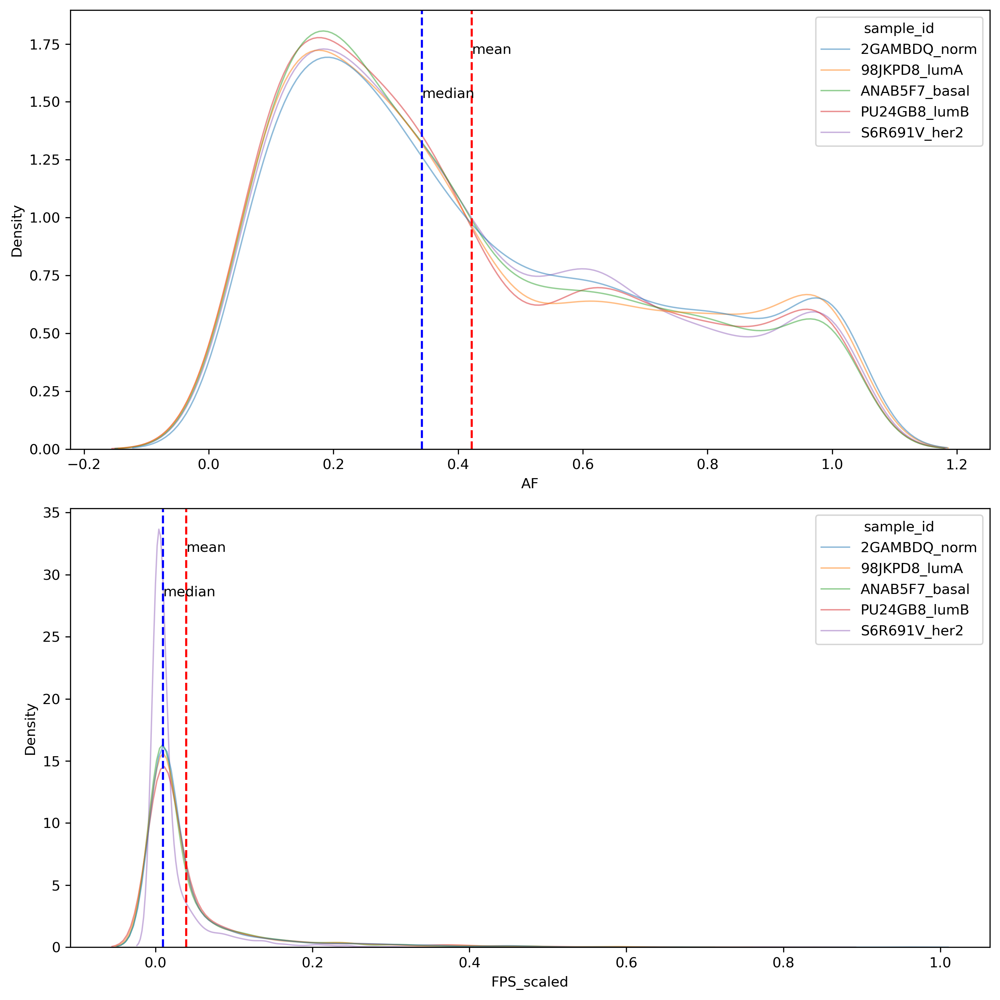

In [56]:
# plot fps_scaled distribution
plt.figure(figsize=(10, 10), dpi=300)
plt.subplot(2, 1, 1)
sns.kdeplot(data=mf_df_s2, x="AF", hue="sample_id", fill=False, common_norm=False, alpha=.5, linewidth=1)
plt.axvline(x=mf_df_s2['AF'].mean(), color='red', linestyle='--')
plt.text(mf_df_s2['AF'].mean(), plt.gca().get_ylim()[1]*0.9, 'mean', fontsize=10)
plt.axvline(x=mf_df_s2['AF'].median(), color='blue', linestyle='--')
plt.text(mf_df_s2['AF'].median(), plt.gca().get_ylim()[1]*0.8, 'median', fontsize=10)

plt.subplot(2, 1, 2)
sns.kdeplot(data=mf_df_s2, x="FPS_scaled", hue="sample_id", fill=False, common_norm=False, alpha=.5, linewidth=1)
plt.axvline(x=fps_scaled_global_mean, color='red', linestyle='--')
plt.text(fps_scaled_global_mean, plt.gca().get_ylim()[1]*0.9, 'mean', fontsize=10)
plt.axvline(x=fps_scaled_global_median, color='blue', linestyle='--')
plt.text(fps_scaled_global_median, plt.gca().get_ylim()[1]*0.8, 'median', fontsize=10)
plt.tight_layout()
plt.show()

It seems like using mean is more stringent than using median to filter out noise. Let's use the mean.

Now we can filter the dataframes to retain only rows that have `FPS_scaled` values above the mean.

In [57]:
# subset region_id with FPS_scaled > mean
# first subset per region_id and then filter for those with FPS_scaled > mean for any subtype
high_af_fpsgtmean_any = high_af.groupby('region_id').filter(lambda x: (x['FPS_scaled'] > fps_scaled_global_mean).any())
high_af_fpsgtmean_any

,region_id,sample_id,AF,FPS,FPS_scaled,FPS_var,FPS_scaled_var,AF_var
5,chr1:977015-977026,2GAMBDQ_norm,1.000000,1.30155,0.345779,0.117365,0.013981,0.00151
6,chr1:977015-977026,98JKPD8_lumA,1.000000,1.10047,0.290240,0.117365,0.013981,0.00151
7,chr1:977015-977026,ANAB5F7_basal,0.941176,0.50514,0.128336,0.117365,0.013981,0.00151
8,chr1:977015-977026,PU24GB8_lumB,0.947368,1.21305,0.330112,0.117365,0.013981,0.00151
9,chr1:977015-977026,S6R691V_her2,0.911765,0.71035,0.092845,0.117365,0.013981,0.00151
...,...,...,...,...,...,...,...,...
11825,chrX:130110575-130110586,2GAMBDQ_norm,1.000000,0.30947,0.082216,0.000501,0.000447,0.00000
11826,chrX:130110575-130110586,98JKPD8_lumA,1.000000,0.28776,0.075894,0.000501,0.000447,0.00000
11827,chrX:130110575-130110586,ANAB5F7_basal,1.000000,0.32931,0.083664,0.000501,0.000447,0.00000
11828,chrX:130110575-130110586,PU24GB8_lumB,1.000000,0.33561,0.091331,0.000501,0.000447,0.00000


/Users/sufyazi/Applications/bin/miniforge3/envs/quarto-docs/lib/python3.12/site-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/Users/sufyazi/Applications/bin/miniforge3/envs/quarto-docs/lib/python3.12/site-packages/seaborn/_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
/Users/sufyazi/Applications/bin/miniforge3/envs/quarto-docs/lib/python3.12/site-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/Users/sufyazi/Applications/bin/miniforge3/envs/quarto-docs/lib/python3.12/si

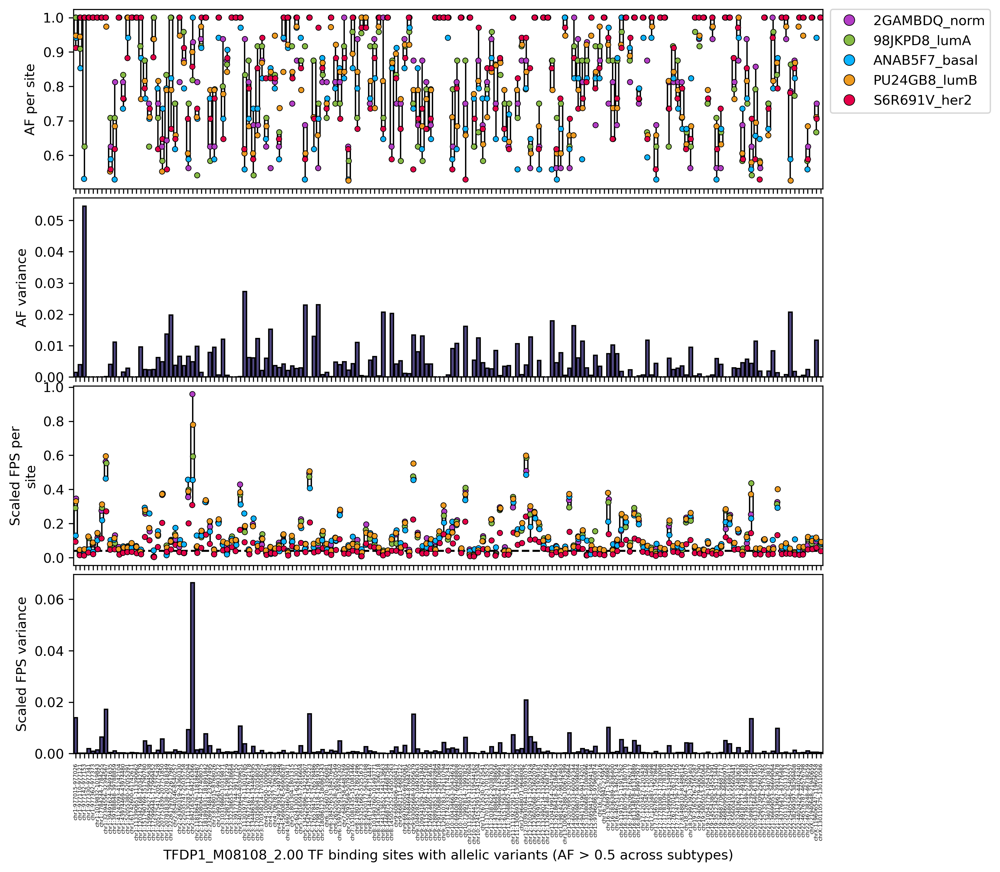

In [58]:
# create color dictionary
dutchfield_colordict = {'S6R691V_her2': "#e60049", 'ANAB5F7_basal': "#0bb4ff", '98JKPD8_lumA': "#87bc45", 'PU24GB8_lumB': "#ef9b20", '2GAMBDQ_norm': "#b33dc6"}
plt.figure(figsize=(10, 10), dpi=300)
# specify subplot
plt.subplot(4, 1, 1)
sns.boxplot(x='region_id', y='AF', data=high_af_fpsgtmean_any, color='whitesmoke', linecolor='black', showfliers=False)
sns.stripplot(x='region_id', y='AF', data=high_af_fpsgtmean_any, hue='sample_id', palette=dutchfield_colordict, size=4, jitter=True, linewidth=0.5, edgecolor='black')
plt.xticks(ticks=plt.xticks()[0], labels=[])
plt.xlabel('')
ylabel = textwrap.fill('AF per site', width=15)
plt.ylabel(ylabel, fontsize=10)
# place legend outside of the plot
plt.legend(bbox_to_anchor=(1.01, 1),borderaxespad=0, markerscale=2, fontsize=10)

plt.subplot(4, 1, 2)
sns.barplot(x='region_id', y='AF_var', data=high_af_fpsgtmean_any, color='darkslateblue', edgecolor='black')
plt.xticks(ticks=plt.xticks()[0], labels=[])
plt.xlabel('')
ylabel = textwrap.fill('AF variance', width=15)
plt.ylabel(ylabel, fontsize=10)
  
plt.subplot(4, 1, 3)
sns.boxplot(x='region_id', y='FPS_scaled', data=high_af_fpsgtmean_any, color='whitesmoke', linecolor='black', showfliers=False)
sns.stripplot(x='region_id', y='FPS_scaled', data=high_af_fpsgtmean_any, hue='sample_id', palette=dutchfield_colordict, size=4, jitter=True, legend=False, linewidth=0.5, edgecolor='black')
# plot horizontal line at fps_scaled_global_median
plt.axhline(y=fps_scaled_global_mean, color='black', linestyle='--')
plt.xticks(ticks=plt.xticks()[0], labels=[])
plt.xlabel('')
ylabel = textwrap.fill('Scaled FPS per site', width=15)
plt.ylabel(ylabel, fontsize=10)

plt.subplot(4, 1, 4)
sns.barplot(x='region_id', y='FPS_scaled_var', data=high_af_fpsgtmean_any, color='darkslateblue', edgecolor='black')
plt.xticks(rotation=90, fontsize=4)
plt.xlabel(f'{motif_id} TF binding sites with allelic variants (AF > 0.5 across subtypes)', fontsize=10)
plt.ylabel('Scaled FPS variance', fontsize=10)
plt.subplots_adjust(hspace=0.05)
plt.show()

'any' FPS scaled value does not seem to really retain any highly variable sites across subtypes (that spans across the mean value in the plot) so let's retain only sites that have `all` FPS scaled values above the mean.

In [59]:
# subset region_id with FPS_scaled > mean
# subset per region_id and then filter for those with FPS_scaled > mean for all subtype
high_af_fpsgtmean_all = high_af.groupby('region_id').filter(lambda x: (x['FPS_scaled'] > fps_scaled_global_mean).all())
high_af_fpsgtmean_all

,region_id,sample_id,AF,FPS,FPS_scaled,FPS_var,FPS_scaled_var,AF_var
5,chr1:977015-977026,2GAMBDQ_norm,1.000000,1.30155,0.345779,0.117365,0.013981,0.00151
6,chr1:977015-977026,98JKPD8_lumA,1.000000,1.10047,0.290240,0.117365,0.013981,0.00151
7,chr1:977015-977026,ANAB5F7_basal,0.941176,0.50514,0.128336,0.117365,0.013981,0.00151
8,chr1:977015-977026,PU24GB8_lumB,0.947368,1.21305,0.330112,0.117365,0.013981,0.00151
9,chr1:977015-977026,S6R691V_her2,0.911765,0.71035,0.092845,0.117365,0.013981,0.00151
...,...,...,...,...,...,...,...,...
11810,chrX:119606547-119606558,2GAMBDQ_norm,0.750000,0.35600,0.094577,0.001173,0.000570,0.01172
11811,chrX:119606547-119606558,98JKPD8_lumA,0.666667,0.42368,0.111742,0.001173,0.000570,0.01172
11812,chrX:119606547-119606558,ANAB5F7_basal,0.941176,0.42560,0.108128,0.001173,0.000570,0.01172
11813,chrX:119606547-119606558,PU24GB8_lumB,0.710526,0.43062,0.117186,0.001173,0.000570,0.01172


/Users/sufyazi/Applications/bin/miniforge3/envs/quarto-docs/lib/python3.12/site-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/Users/sufyazi/Applications/bin/miniforge3/envs/quarto-docs/lib/python3.12/site-packages/seaborn/_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
/Users/sufyazi/Applications/bin/miniforge3/envs/quarto-docs/lib/python3.12/site-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/Users/sufyazi/Applications/bin/miniforge3/envs/quarto-docs/lib/python3.12/si

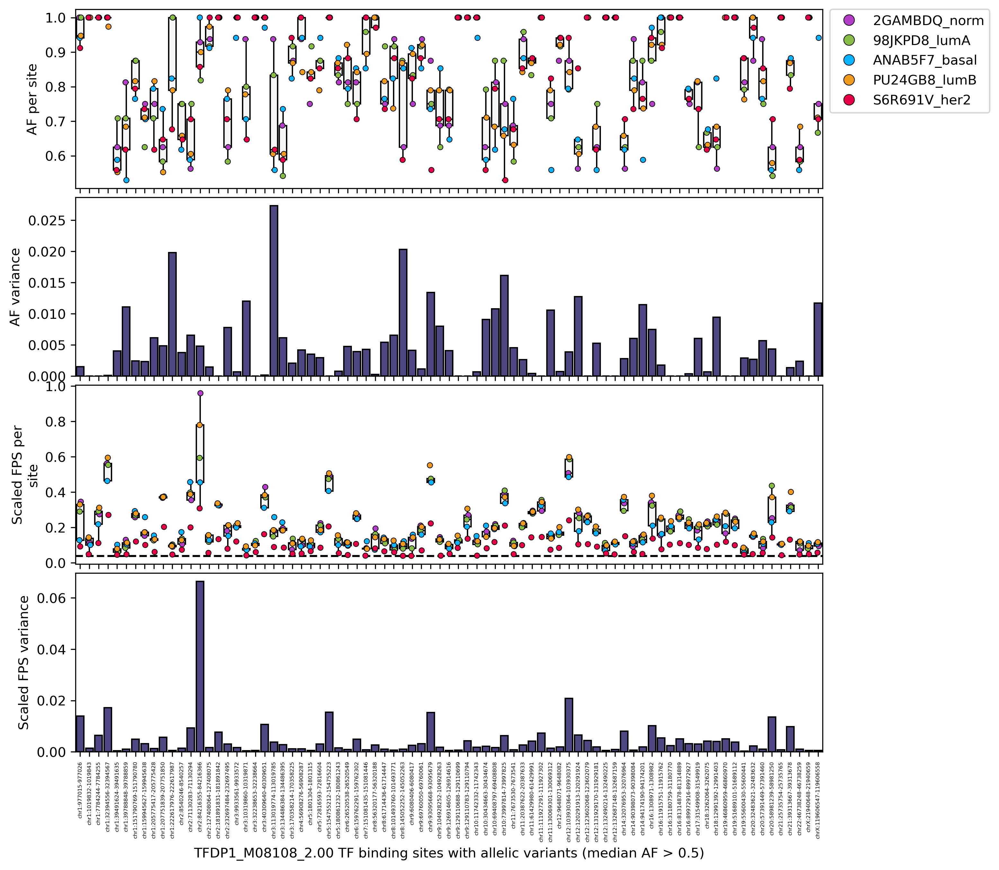

In [60]:
dutchfield_colordict = {'S6R691V_her2': "#e60049", 'ANAB5F7_basal': "#0bb4ff", '98JKPD8_lumA': "#87bc45", 'PU24GB8_lumB': "#ef9b20", '2GAMBDQ_norm': "#b33dc6"}
plt.figure(figsize=(10, 10), dpi=300)
# specify subplot
plt.subplot(4, 1, 1)
sns.boxplot(x='region_id', y='AF', data=high_af_fpsgtmean_all, color='whitesmoke', linecolor='black', showfliers=False)
sns.stripplot(x='region_id', y='AF', data=high_af_fpsgtmean_all, hue='sample_id', palette=dutchfield_colordict, size=4, jitter=True, linewidth=0.5, edgecolor='black')
plt.xticks(ticks=plt.xticks()[0], labels=[])
plt.xlabel('')
ylabel = textwrap.fill('AF per site', width=15)
plt.ylabel(ylabel, fontsize=10)
# place legend outside of the plot
plt.legend(bbox_to_anchor=(1.01, 1),borderaxespad=0, markerscale=2, fontsize=10)

plt.subplot(4, 1, 2)
sns.barplot(x='region_id', y='AF_var', data=high_af_fpsgtmean_all, color='darkslateblue', edgecolor='black')
plt.xticks(ticks=plt.xticks()[0], labels=[])
plt.xlabel('')
ylabel = textwrap.fill('AF variance', width=15)
plt.ylabel(ylabel, fontsize=10)
  
plt.subplot(4, 1, 3)
sns.boxplot(x='region_id', y='FPS_scaled', data=high_af_fpsgtmean_all, color='whitesmoke', linecolor='black', showfliers=False)
sns.stripplot(x='region_id', y='FPS_scaled', data=high_af_fpsgtmean_all, hue='sample_id', palette=dutchfield_colordict, size=4, jitter=True, legend=False, linewidth=0.5, edgecolor='black')
# plot horizontal line at fps_scaled_global_mean
plt.axhline(y=fps_scaled_global_mean, color='black', linestyle='--')
plt.xticks(ticks=plt.xticks()[0], labels=[])
plt.xlabel('')
ylabel = textwrap.fill('Scaled FPS per site', width=15)
plt.ylabel(ylabel, fontsize=10)

plt.subplot(4, 1, 4)
sns.barplot(x='region_id', y='FPS_scaled_var', data=high_af_fpsgtmean_all, color='darkslateblue', edgecolor='black')
plt.xticks(rotation=90, fontsize=4)
plt.xlabel(f'{motif_id} TF binding sites with allelic variants (median AF > 0.5)', fontsize=10)
plt.ylabel('Scaled FPS variance', fontsize=10)
plt.subplots_adjust(hspace=0.05)
plt.show()

Now that it looks pretty valid, we would also like to subset the unsplit dataframe for FPS values that are below the mean across all subtypes with high AF values as well as FPS values that are above and below the mean across all subtypes with low AF values.

In [61]:
# subset per region_id and then filter for those with FPS_scaled < mean for all subtype
high_af_fpsltmean_all = high_af.groupby('region_id').filter(lambda x: (x['FPS_scaled'] <= fps_scaled_global_mean).all())
high_af_fpsltmean_all

,region_id,sample_id,AF,FPS,FPS_scaled,FPS_var,FPS_scaled_var,AF_var
0,chr1:818021-818032,2GAMBDQ_norm,0.875000,0.03443,0.009147,0.000068,0.000010,0.001576
1,chr1:818021-818032,98JKPD8_lumA,0.900000,0.02966,0.007823,0.000068,0.000010,0.001576
2,chr1:818021-818032,ANAB5F7_basal,0.812500,0.04399,0.011176,0.000068,0.000010,0.001576
3,chr1:818021-818032,PU24GB8_lumB,0.833333,0.03470,0.009443,0.000068,0.000010,0.001576
4,chr1:818021-818032,S6R691V_her2,0.900000,0.02131,0.002785,0.000068,0.000010,0.001576
...,...,...,...,...,...,...,...,...
11840,chrX:153495405-153495416,2GAMBDQ_norm,1.000000,0.02562,0.006806,0.000059,0.000003,0.002347
11841,chrX:153495405-153495416,98JKPD8_lumA,1.000000,0.01647,0.004344,0.000059,0.000003,0.002347
11842,chrX:153495405-153495416,ANAB5F7_basal,0.882353,0.03213,0.008163,0.000059,0.000003,0.002347
11843,chrX:153495405-153495416,PU24GB8_lumB,0.973684,0.01603,0.004362,0.000059,0.000003,0.002347


In [62]:
# subset per region_id and then filter for those with FPS_scaled < mean for all subtype
low_af_fpsltmean_all = low_af.groupby('region_id').filter(lambda x: (x['FPS_scaled'] <= fps_scaled_global_mean).all())
low_af_fpsltmean_all

,region_id,sample_id,AF,FPS,FPS_scaled,FPS_var,FPS_scaled_var,AF_var
35,chr1:986626-986637,2GAMBDQ_norm,0.142857,0.04807,0.012771,0.000305,0.000032,0.002325
36,chr1:986626-986637,98JKPD8_lumA,0.166667,0.06207,0.016370,0.000305,0.000032,0.002325
37,chr1:986626-986637,ANAB5F7_basal,0.156250,0.01957,0.004972,0.000305,0.000032,0.002325
38,chr1:986626-986637,PU24GB8_lumB,0.176471,0.05148,0.014009,0.000305,0.000032,0.002325
39,chr1:986626-986637,S6R691V_her2,0.264706,0.02828,0.003696,0.000305,0.000032,0.002325
...,...,...,...,...,...,...,...,...
11800,chrX:107655092-107655103,2GAMBDQ_norm,0.125000,0.03608,0.009585,0.000099,0.000011,0.003296
11801,chrX:107655092-107655103,98JKPD8_lumA,0.125000,0.05553,0.014646,0.000099,0.000011,0.003296
11802,chrX:107655092-107655103,ANAB5F7_basal,0.250000,0.05358,0.013613,0.000099,0.000011,0.003296
11803,chrX:107655092-107655103,PU24GB8_lumB,0.131579,0.03495,0.009511,0.000099,0.000011,0.003296


In [63]:
# subset per region_id and then filter for those with FPS_scaled < mean for all subtype
low_af_fpsgtmean_all = low_af.groupby('region_id').filter(lambda x: (x['FPS_scaled'] > fps_scaled_global_mean).all())
low_af_fpsgtmean_all

,region_id,sample_id,AF,FPS,FPS_scaled,FPS_var,FPS_scaled_var,AF_var
95,chr1:3857731-3857742,2GAMBDQ_norm,0.437500,0.36332,0.096522,0.002529,0.000814,0.014514
96,chr1:3857731-3857742,98JKPD8_lumA,0.208333,0.46706,0.123183,0.002529,0.000814,0.014514
97,chr1:3857731-3857742,ANAB5F7_basal,0.117647,0.42055,0.106845,0.002529,0.000814,0.014514
98,chr1:3857731-3857742,PU24GB8_lumB,0.184211,0.35094,0.095503,0.002529,0.000814,0.014514
99,chr1:3857731-3857742,S6R691V_her2,0.235294,0.35795,0.046785,0.002529,0.000814,0.014514
...,...,...,...,...,...,...,...,...
11755,chrX:41335077-41335088,2GAMBDQ_norm,0.187500,0.57554,0.152902,0.007788,0.001851,0.007221
11756,chrX:41335077-41335088,98JKPD8_lumA,0.416667,0.65885,0.173767,0.007788,0.001851,0.007221
11757,chrX:41335077-41335088,ANAB5F7_basal,0.294118,0.41852,0.106329,0.007788,0.001851,0.007221
11758,chrX:41335077-41335088,PU24GB8_lumB,0.289474,0.58775,0.159947,0.007788,0.001851,0.007221


Now we can sort the dataframe by `region_id` based on the descending order of `FPS_scaled_var` values.

In [64]:
### strat 1 dataframe
high_af_uniq_reg = high_nzaf_outliers[['region_id', 'AF_var', 'FPS_scaled_var']].drop_duplicates()
# sort the region_id in the filtered high_af dataframe based on descending order of FPS_scaled_var
fpsvar_uniqsort = high_af_uniq_reg.sort_values(by='FPS_scaled_var', ascending=False)
# extract the region_id from the high_af_fps_var_df_uniqsort dataframe
sorted_region_ids = fpsvar_uniqsort['region_id']
# Change 'region_id' to a categorical variable with the categories ordered by 'sorted_region_ids'
df_copy = high_nzaf_outliers.copy()
df_copy['region_id'] = pd.Categorical(high_nzaf_outliers['region_id'], categories=sorted_region_ids, ordered=True)
# Filter the DataFrame
high_nzaf_filtered = df_copy[df_copy['region_id'].isin(sorted_region_ids)]

# Sort the DataFrame by 'region_id'
high_nzaf_filtered = high_nzaf_filtered.sort_values('region_id')
high_nzaf_filtered

,region_id,sample_id,AF,FPS,FPS_scaled,FPS_var,FPS_scaled_var,AF_var
1325,chr2:84216355-84216366,2GAMBDQ_norm,0.928571,3.60913,0.958827,0.480584,0.066372,0.004836
1327,chr2:84216355-84216366,ANAB5F7_basal,1.000000,1.79019,0.454815,0.480584,0.066372,0.004836
1328,chr2:84216355-84216366,PU24GB8_lumB,0.900000,2.86361,0.779286,0.480584,0.066372,0.004836
1329,chr2:84216355-84216366,S6R691V_her2,0.857143,2.35684,0.308047,0.480584,0.066372,0.004836
1326,chr2:84216355-84216366,98JKPD8_lumA,0.818182,2.24927,0.593228,0.480584,0.066372,0.004836
...,...,...,...,...,...,...,...,...
8137,chr14:90398073-90398084,ANAB5F7_basal,0.823529,0.43186,0.109718,0.002642,0.000669,0.006053
8139,chr14:90398073-90398084,S6R691V_her2,0.735294,0.46845,0.061228,0.002642,0.000669,0.006053
8135,chr14:90398073-90398084,2GAMBDQ_norm,0.937500,0.34468,0.091570,0.002642,0.000669,0.006053
8136,chr14:90398073-90398084,98JKPD8_lumA,0.875000,0.47013,0.123993,0.002642,0.000669,0.006053


In [65]:
# strat 2
uniq_reg = high_af_fpsgtmean_all[['region_id', 'AF_var', 'FPS_scaled_var']].drop_duplicates()
# sort the region_id in the filtered high_af dataframe based on descending order of FPS_scaled_var
fpsvar_uniqsort = uniq_reg.sort_values(by='FPS_scaled_var', ascending=False)
# extract the region_id from the high_af_fps_var_df_uniqsort dataframe
sorted_region_ids = fpsvar_uniqsort['region_id']
# Change 'region_id' to a categorical variable with the categories ordered by 'sorted_region_ids'
df_copy = high_af_fpsgtmean_all.copy()
df_copy['region_id'] = pd.Categorical(high_af_fpsgtmean_all['region_id'], categories=sorted_region_ids, ordered=True)
# Filter the DataFrame
high_af_fpsgtmean_filt = df_copy[df_copy['region_id'].isin(sorted_region_ids)]
# Sort the DataFrame by 'region_id'
high_af_fpsgtmean_filtered = high_af_fpsgtmean_filt.sort_values('region_id')


uniq_reg = low_af_fpsgtmean_all[['region_id', 'AF_var', 'FPS_scaled_var']].drop_duplicates()
# sort the region_id in the filtered high_af dataframe based on descending order of FPS_scaled_var
fpsvar_uniqsort = uniq_reg.sort_values(by='FPS_scaled_var', ascending=False)
# extract the region_id from the high_af_fps_var_df_uniqsort dataframe
sorted_region_ids = fpsvar_uniqsort['region_id']
# Change 'region_id' to a categorical variable with the categories ordered by 'sorted_region_ids'
df_copy = low_af_fpsgtmean_all.copy()
df_copy['region_id'] = pd.Categorical(low_af_fpsgtmean_all['region_id'], categories=sorted_region_ids, ordered=True)
# Filter the DataFrame
low_af_fpsgtmean_filt = df_copy[df_copy['region_id'].isin(sorted_region_ids)]
# Sort the DataFrame by 'region_id'
low_af_fpsgtmean_filtered = low_af_fpsgtmean_filt.sort_values('region_id')


uniq_reg = high_af_fpsltmean_all[['region_id', 'AF_var', 'FPS_scaled_var']].drop_duplicates()
# sort the region_id in the filtered high_af dataframe based on descending order of FPS_scaled_var
fpsvar_uniqsort = uniq_reg.sort_values(by='FPS_scaled_var', ascending=False)
# extract the region_id from the high_af_fps_var_df_uniqsort dataframe
sorted_region_ids = fpsvar_uniqsort['region_id']
# Change 'region_id' to a categorical variable with the categories ordered by 'sorted_region_ids'
df_copy = high_af_fpsltmean_all.copy()
df_copy['region_id'] = pd.Categorical(high_af_fpsltmean_all['region_id'], categories=sorted_region_ids, ordered=True)
# Filter the DataFrame
high_af_fpsltmean_filt = df_copy[df_copy['region_id'].isin(sorted_region_ids)]
# Sort the DataFrame by 'region_id'
high_af_fpsltmean_filtered = high_af_fpsltmean_filt.sort_values('region_id')


uniq_reg = low_af_fpsltmean_all[['region_id', 'AF_var', 'FPS_scaled_var']].drop_duplicates()
# sort the region_id in the filtered high_af dataframe based on descending order of FPS_scaled_var
fpsvar_uniqsort = uniq_reg.sort_values(by='FPS_scaled_var', ascending=False)
# extract the region_id from the high_af_fps_var_df_uniqsort dataframe
sorted_region_ids = fpsvar_uniqsort['region_id']
# Change 'region_id' to a categorical variable with the categories ordered by 'sorted_region_ids'
df_copy = low_af_fpsltmean_all.copy()
df_copy['region_id'] = pd.Categorical(low_af_fpsltmean_all['region_id'], categories=sorted_region_ids, ordered=True)
# Filter the DataFrame
low_af_fpsltmean_filt = df_copy[df_copy['region_id'].isin(sorted_region_ids)]
# Sort the DataFrame by 'region_id'
low_af_fpsltmean_filtered = low_af_fpsltmean_filt.sort_values('region_id')


Next, sort the sample_id values per each unique region_id by a specific order. This order is based on the lexicographic order of the sample_id values in the original matrix.

In [66]:
# get unique sample_id values into a list to define a categorical order
datasets = high_nzaf_filtered['sample_id'].unique().tolist()
datasets = sorted(datasets)

# Create a categorical variable with ordered categories
dataset_copy = high_nzaf_filtered.copy()
dataset_copy['sample_id'] = pd.Categorical(dataset_copy['sample_id'], categories=datasets, ordered=True)

# Sort 'sample_id' within each 'region_id'
high_nzaf_filtsorted = dataset_copy.groupby('region_id', sort=False, observed=False).apply(lambda x: x.sort_values('sample_id')).reset_index(drop=True)

# do the same for high_af_fpsgtmean_all, low_af_fpsgtmean_all, high_af_fpsltmean_all, low_af_fpsltmean_all

dataset_copy = high_af_fpsgtmean_filtered.copy()
dataset_copy['sample_id'] = pd.Categorical(dataset_copy['sample_id'], categories=datasets, ordered=True)
high_af_fpsgtmean_filtsorted = dataset_copy.groupby('region_id', sort=False, observed=False).apply(lambda x: x.sort_values('sample_id')).reset_index(drop=True)

dataset_copy = low_af_fpsgtmean_filtered.copy()
dataset_copy['sample_id'] = pd.Categorical(dataset_copy['sample_id'], categories=datasets, ordered=True)
low_af_fpsgtmean_filtsorted = dataset_copy.groupby('region_id', sort=False, observed=False).apply(lambda x: x.sort_values('sample_id')).reset_index(drop=True)

dataset_copy = high_af_fpsltmean_filtered.copy()
dataset_copy['sample_id'] = pd.Categorical(dataset_copy['sample_id'], categories=datasets, ordered=True)
high_af_fpsltmean_filtsorted = dataset_copy.groupby('region_id', sort=False, observed=False).apply(lambda x: x.sort_values('sample_id')).reset_index(drop=True)

dataset_copy = low_af_fpsltmean_filtered.copy()
dataset_copy['sample_id'] = pd.Categorical(dataset_copy['sample_id'], categories=datasets, ordered=True)
low_af_fpsltmean_filtsorted = dataset_copy.groupby('region_id', sort=False, observed=False).apply(lambda x: x.sort_values('sample_id')).reset_index(drop=True)


/var/folders/cj/48kxs2k94p7fmnmdbb42jxv00000gn/T/ipykernel_21389/3123881717.py:10: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  high_nzaf_filtsorted = dataset_copy.groupby('region_id', sort=False, observed=False).apply(lambda x: x.sort_values('sample_id')).reset_index(drop=True)
/var/folders/cj/48kxs2k94p7fmnmdbb42jxv00000gn/T/ipykernel_21389/3123881717.py:16: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  

In [67]:
high_nzaf_filtsorted.head()

,region_id,sample_id,AF,FPS,FPS_scaled,FPS_var,FPS_scaled_var,AF_var
0,chr2:84216355-84216366,2GAMBDQ_norm,0.928571,3.60913,0.958827,0.480584,0.066372,0.004836
1,chr2:84216355-84216366,98JKPD8_lumA,0.818182,2.24927,0.593228,0.480584,0.066372,0.004836
2,chr2:84216355-84216366,ANAB5F7_basal,1.000000,1.79019,0.454815,0.480584,0.066372,0.004836
3,chr2:84216355-84216366,PU24GB8_lumB,0.900000,2.86361,0.779286,0.480584,0.066372,0.004836
4,chr2:84216355-84216366,S6R691V_her2,0.857143,2.35684,0.308047,0.480584,0.066372,0.004836


In [68]:
high_af_fpsgtmean_filtsorted.head()

,region_id,sample_id,AF,FPS,FPS_scaled,FPS_var,FPS_scaled_var,AF_var
0,chr2:84216355-84216366,2GAMBDQ_norm,0.928571,3.60913,0.958827,0.480584,0.066372,0.004836
1,chr2:84216355-84216366,98JKPD8_lumA,0.818182,2.24927,0.593228,0.480584,0.066372,0.004836
2,chr2:84216355-84216366,ANAB5F7_basal,1.000000,1.79019,0.454815,0.480584,0.066372,0.004836
3,chr2:84216355-84216366,PU24GB8_lumB,0.900000,2.86361,0.779286,0.480584,0.066372,0.004836
4,chr2:84216355-84216366,S6R691V_her2,0.857143,2.35684,0.308047,0.480584,0.066372,0.004836


In [69]:
low_af_fpsgtmean_filtsorted.head()

,region_id,sample_id,AF,FPS,FPS_scaled,FPS_var,FPS_scaled_var,AF_var
0,chr8:126558440-126558451,2GAMBDQ_norm,0.125000,1.95375,0.519047,0.236964,0.038931,0.001337
1,chr8:126558440-126558451,98JKPD8_lumA,0.166667,2.03162,0.535824,0.236964,0.038931,0.001337
2,chr8:126558440-126558451,ANAB5F7_basal,0.088235,1.87539,0.476461,0.236964,0.038931,0.001337
3,chr8:126558440-126558451,PU24GB8_lumB,0.078947,3.06962,0.835348,0.236964,0.038931,0.001337
4,chr8:126558440-126558451,S6R691V_her2,0.088235,2.18924,0.286141,0.236964,0.038931,0.001337


In [70]:
high_af_fpsltmean_filtsorted.head()

,region_id,sample_id,AF,FPS,FPS_scaled,FPS_var,FPS_scaled_var,AF_var
0,chr19:35306373-35306384,2GAMBDQ_norm,0.812500,0.07781,0.020672,0.002463,0.000214,0.008205
1,chr19:35306373-35306384,98JKPD8_lumA,0.590909,0.09118,0.024048,0.002463,0.000214,0.008205
2,chr19:35306373-35306384,ANAB5F7_basal,0.600000,0.01374,0.003491,0.002463,0.000214,0.008205
3,chr19:35306373-35306384,PU24GB8_lumB,0.657895,0.14387,0.039152,0.002463,0.000214,0.008205
4,chr19:35306373-35306384,S6R691V_her2,0.625000,0.04190,0.005476,0.002463,0.000214,0.008205


In [71]:
low_af_fpsltmean_filtsorted.head()

,region_id,sample_id,AF,FPS,FPS_scaled,FPS_var,FPS_scaled_var,AF_var
0,chr16:54066087-54066098,2GAMBDQ_norm,0.187500,0.06869,0.018249,0.001838,0.000162,0.005087
1,chr16:54066087-54066098,98JKPD8_lumA,0.208333,0.14332,0.037800,0.001838,0.000162,0.005087
2,chr16:54066087-54066098,ANAB5F7_basal,0.352941,0.02967,0.007538,0.001838,0.000162,0.005087
3,chr16:54066087-54066098,PU24GB8_lumB,0.264706,0.08437,0.022960,0.001838,0.000162,0.005087
4,chr16:54066087-54066098,S6R691V_her2,0.323529,0.05253,0.006866,0.001838,0.000162,0.005087


/Users/sufyazi/Applications/bin/miniforge3/envs/quarto-docs/lib/python3.12/site-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/Users/sufyazi/Applications/bin/miniforge3/envs/quarto-docs/lib/python3.12/site-packages/seaborn/_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
/Users/sufyazi/Applications/bin/miniforge3/envs/quarto-docs/lib/python3.12/site-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/Users/sufyazi/Applications/bin/miniforge3/envs/quarto-docs/lib/python3.12/si

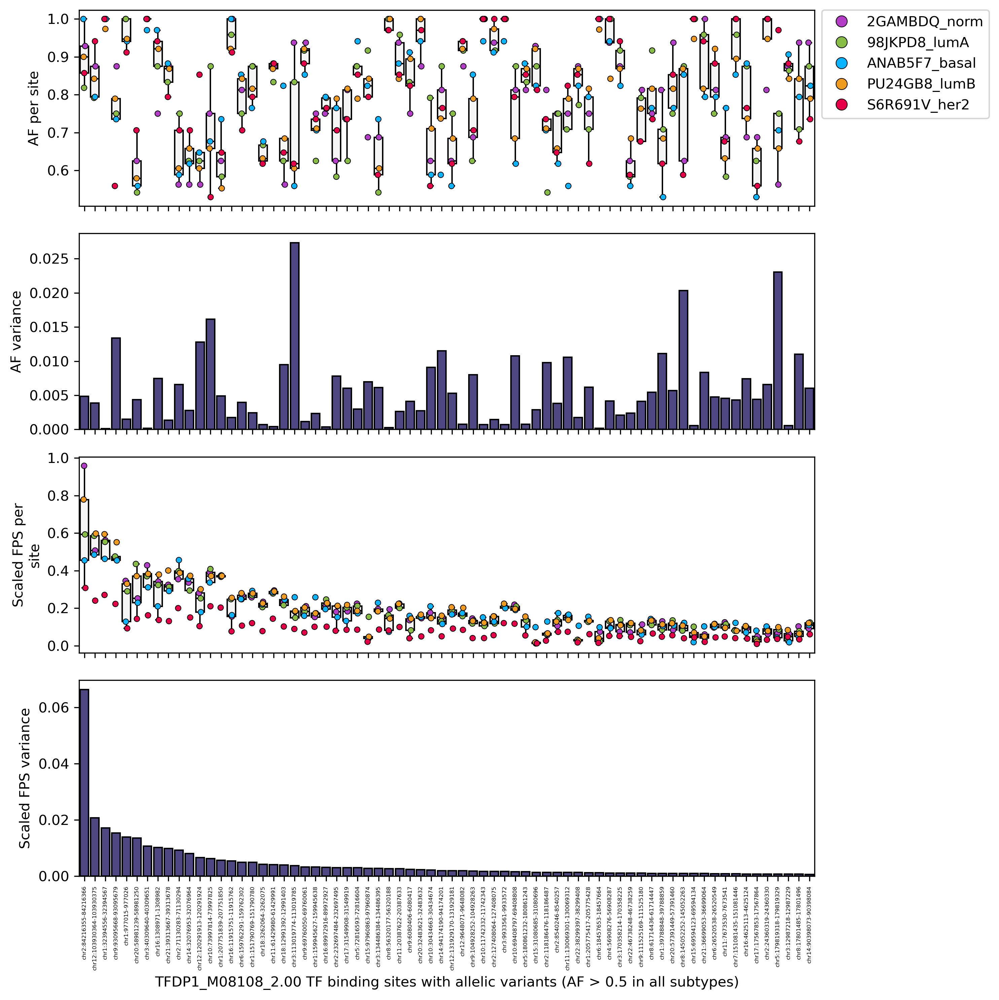

In [72]:
dutchfield_colordict = {'S6R691V_her2': "#e60049", 'ANAB5F7_basal': "#0bb4ff", '98JKPD8_lumA': "#87bc45", 'PU24GB8_lumB': "#ef9b20", '2GAMBDQ_norm': "#b33dc6"}
plt.figure(figsize=(10, 10), dpi=300)
# specify subplot
plt.subplot(4, 1, 1)
sns.boxplot(x='region_id', y='AF', data=high_nzaf_filtsorted, color='whitesmoke', linecolor='black', showfliers=False)
sns.stripplot(x='region_id', y='AF', data=high_nzaf_filtsorted, hue='sample_id', palette=dutchfield_colordict, size=4, jitter=True, linewidth=0.5, edgecolor='black')
plt.xticks(ticks=plt.xticks()[0], labels=[])
plt.xlabel('')
ylabel = textwrap.fill('AF per site', width=15)
plt.ylabel(ylabel, fontsize=10)
# place legend outside of the plot
plt.legend(bbox_to_anchor=(1.01, 1),borderaxespad=0, markerscale=2, fontsize=10)

plt.subplot(4, 1, 2)
sns.barplot(x='region_id', y='AF_var', data=high_nzaf_filtsorted, color='darkslateblue', edgecolor='black')
plt.xticks(ticks=plt.xticks()[0], labels=[])
plt.xlabel('')
ylabel = textwrap.fill('AF variance', width=15)
plt.ylabel(ylabel, fontsize=10)
  
plt.subplot(4, 1, 3)
sns.boxplot(x='region_id', y='FPS_scaled', data=high_nzaf_filtsorted, color='whitesmoke', linecolor='black', showfliers=False)
sns.stripplot(x='region_id', y='FPS_scaled', data=high_nzaf_filtsorted, hue='sample_id', palette=dutchfield_colordict, size=4, jitter=True, legend=False, linewidth=0.5, edgecolor='black')
plt.xticks(ticks=plt.xticks()[0], labels=[])
plt.xlabel('')
ylabel = textwrap.fill('Scaled FPS per site', width=15)
plt.ylabel(ylabel, fontsize=10)

plt.subplot(4, 1, 4)
sns.barplot(x='region_id', y='FPS_scaled_var', data=high_nzaf_filtsorted, color='darkslateblue', edgecolor='black')
plt.xticks(rotation=90, fontsize=4)
plt.xlabel(f'{motif_id} TF binding sites with allelic variants (AF > 0.5 in all subtypes)', fontsize=10)
plt.ylabel('Scaled FPS variance', fontsize=10)
plt.subplots_adjust(hspace=0.05)
plt.tight_layout()
plt.show()

/Users/sufyazi/Applications/bin/miniforge3/envs/quarto-docs/lib/python3.12/site-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/Users/sufyazi/Applications/bin/miniforge3/envs/quarto-docs/lib/python3.12/site-packages/seaborn/_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
/Users/sufyazi/Applications/bin/miniforge3/envs/quarto-docs/lib/python3.12/site-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/Users/sufyazi/Applications/bin/miniforge3/envs/quarto-docs/lib/python3.12/si

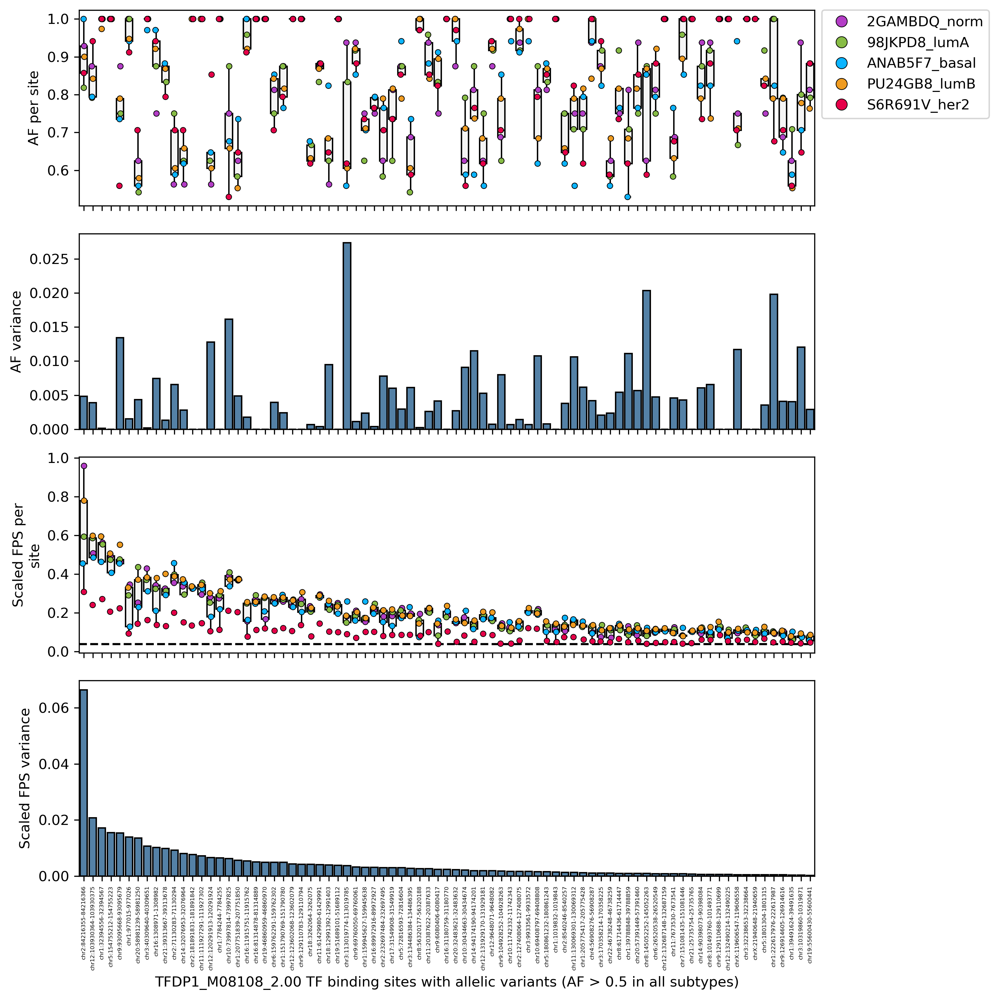

In [73]:
dutchfield_colordict = {'S6R691V_her2': "#e60049", 'ANAB5F7_basal': "#0bb4ff", '98JKPD8_lumA': "#87bc45", 'PU24GB8_lumB': "#ef9b20", '2GAMBDQ_norm': "#b33dc6"}
plt.figure(figsize=(10, 10), dpi=300)
# specify subplot
plt.subplot(4, 1, 1)
sns.boxplot(x='region_id', y='AF', data=high_af_fpsgtmean_filtsorted, color='whitesmoke', linecolor='black', showfliers=False)
sns.stripplot(x='region_id', y='AF', data=high_af_fpsgtmean_filtsorted, hue='sample_id', palette=dutchfield_colordict, size=4, jitter=True, linewidth=0.5, edgecolor='black')
plt.xticks(ticks=plt.xticks()[0], labels=[])
plt.xlabel('')
ylabel = textwrap.fill('AF per site', width=15)
plt.ylabel(ylabel, fontsize=10)
# place legend outside of the plot
plt.legend(bbox_to_anchor=(1.01, 1),borderaxespad=0, markerscale=2, fontsize=10)

plt.subplot(4, 1, 2)
sns.barplot(x='region_id', y='AF_var', data=high_af_fpsgtmean_filtsorted, color='steelblue', edgecolor='black')
plt.xticks(ticks=plt.xticks()[0], labels=[])
plt.xlabel('')
ylabel = textwrap.fill('AF variance', width=15)
plt.ylabel(ylabel, fontsize=10)
  
plt.subplot(4, 1, 3)
sns.boxplot(x='region_id', y='FPS_scaled', data=high_af_fpsgtmean_filtsorted, color='whitesmoke', linecolor='black', showfliers=False)
sns.stripplot(x='region_id', y='FPS_scaled', data=high_af_fpsgtmean_filtsorted, hue='sample_id', palette=dutchfield_colordict, size=4, jitter=True, legend=False, linewidth=0.5, edgecolor='black')
# plot horizontal line at fps_scaled_global_mean
plt.axhline(y=fps_scaled_global_mean, color='black', linestyle='--')
plt.xticks(ticks=plt.xticks()[0], labels=[])
plt.xlabel('')
ylabel = textwrap.fill('Scaled FPS per site', width=15)
plt.ylabel(ylabel, fontsize=10)

plt.subplot(4, 1, 4)
sns.barplot(x='region_id', y='FPS_scaled_var', data=high_af_fpsgtmean_filtsorted, color='steelblue', edgecolor='black')
plt.xticks(rotation=90, fontsize=4)
plt.xlabel(f'{motif_id} TF binding sites with allelic variants (AF > 0.5 in all subtypes)', fontsize=10)
plt.ylabel('Scaled FPS variance', fontsize=10)
plt.subplots_adjust(hspace=0.05)
plt.tight_layout()
plt.show()

/Users/sufyazi/Applications/bin/miniforge3/envs/quarto-docs/lib/python3.12/site-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/Users/sufyazi/Applications/bin/miniforge3/envs/quarto-docs/lib/python3.12/site-packages/seaborn/_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
/Users/sufyazi/Applications/bin/miniforge3/envs/quarto-docs/lib/python3.12/site-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/Users/sufyazi/Applications/bin/miniforge3/envs/quarto-docs/lib/python3.12/si

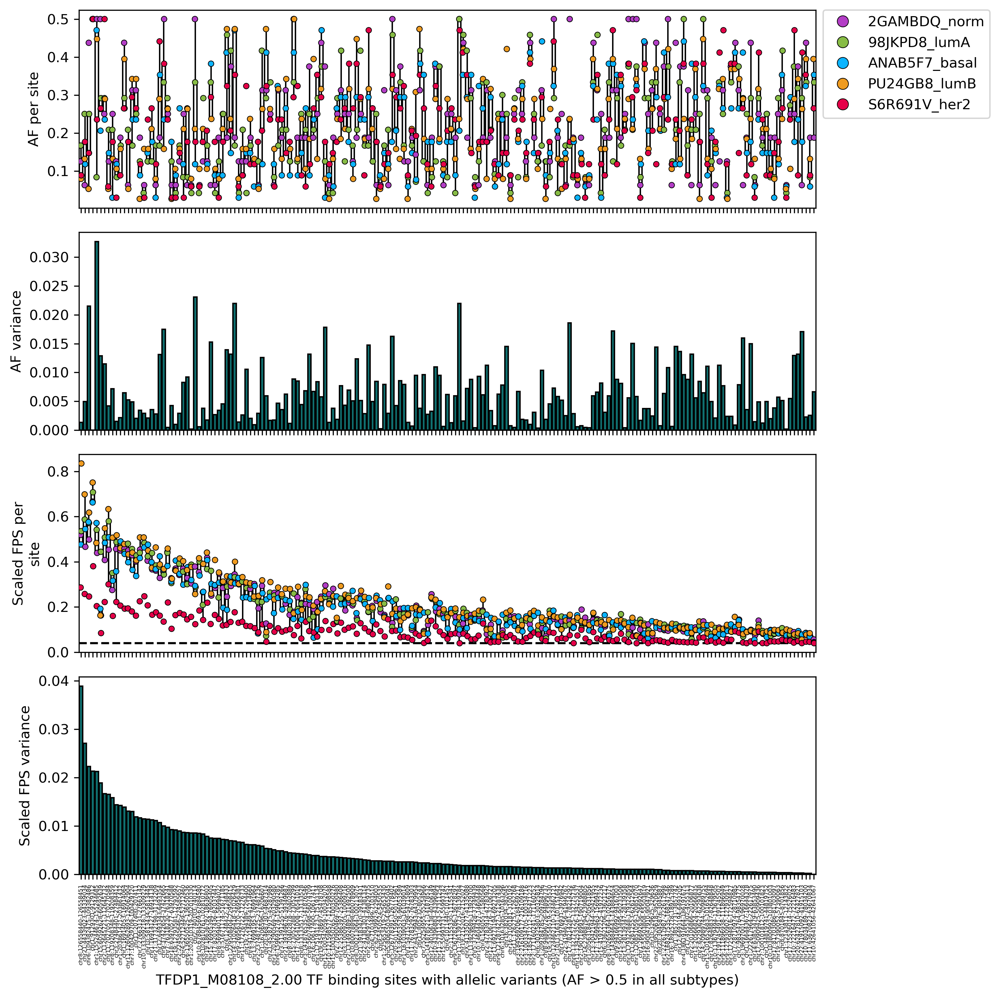

In [74]:
dutchfield_colordict = {'S6R691V_her2': "#e60049", 'ANAB5F7_basal': "#0bb4ff", '98JKPD8_lumA': "#87bc45", 'PU24GB8_lumB': "#ef9b20", '2GAMBDQ_norm': "#b33dc6"}
plt.figure(figsize=(10, 10), dpi=300)
# specify subplot
plt.subplot(4, 1, 1)
sns.boxplot(x='region_id', y='AF', data=low_af_fpsgtmean_filtsorted, color='whitesmoke', linecolor='black', showfliers=False)
sns.stripplot(x='region_id', y='AF', data=low_af_fpsgtmean_filtsorted, hue='sample_id', palette=dutchfield_colordict, size=4, jitter=True, linewidth=0.5, edgecolor='black')
plt.xticks(ticks=plt.xticks()[0], labels=[])
plt.xlabel('')
ylabel = textwrap.fill('AF per site', width=15)
plt.ylabel(ylabel, fontsize=10)
# place legend outside of the plot
plt.legend(bbox_to_anchor=(1.01, 1),borderaxespad=0, markerscale=2, fontsize=10)

plt.subplot(4, 1, 2)
sns.barplot(x='region_id', y='AF_var', data=low_af_fpsgtmean_filtsorted, color='teal', edgecolor='black')
plt.xticks(ticks=plt.xticks()[0], labels=[])
plt.xlabel('')
ylabel = textwrap.fill('AF variance', width=15)
plt.ylabel(ylabel, fontsize=10)
  
plt.subplot(4, 1, 3)
sns.boxplot(x='region_id', y='FPS_scaled', data=low_af_fpsgtmean_filtsorted, color='whitesmoke', linecolor='black', showfliers=False)
sns.stripplot(x='region_id', y='FPS_scaled', data=low_af_fpsgtmean_filtsorted, hue='sample_id', palette=dutchfield_colordict, size=4, jitter=True, legend=False, linewidth=0.5, edgecolor='black')
# plot horizontal line at fps_scaled_global_mean
plt.axhline(y=fps_scaled_global_mean, color='black', linestyle='--')
plt.xticks(ticks=plt.xticks()[0], labels=[])
plt.xlabel('')
ylabel = textwrap.fill('Scaled FPS per site', width=15)
plt.ylabel(ylabel, fontsize=10)

plt.subplot(4, 1, 4)
sns.barplot(x='region_id', y='FPS_scaled_var', data=low_af_fpsgtmean_filtsorted, color='teal', edgecolor='black')
plt.xticks(rotation=90, fontsize=4)
plt.xlabel(f'{motif_id} TF binding sites with allelic variants (AF > 0.5 in all subtypes)', fontsize=10)
plt.ylabel('Scaled FPS variance', fontsize=10)
plt.subplots_adjust(hspace=0.05)
plt.tight_layout()
plt.show()

/Users/sufyazi/Applications/bin/miniforge3/envs/quarto-docs/lib/python3.12/site-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/Users/sufyazi/Applications/bin/miniforge3/envs/quarto-docs/lib/python3.12/site-packages/seaborn/_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
/Users/sufyazi/Applications/bin/miniforge3/envs/quarto-docs/lib/python3.12/site-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/Users/sufyazi/Applications/bin/miniforge3/envs/quarto-docs/lib/python3.12/si

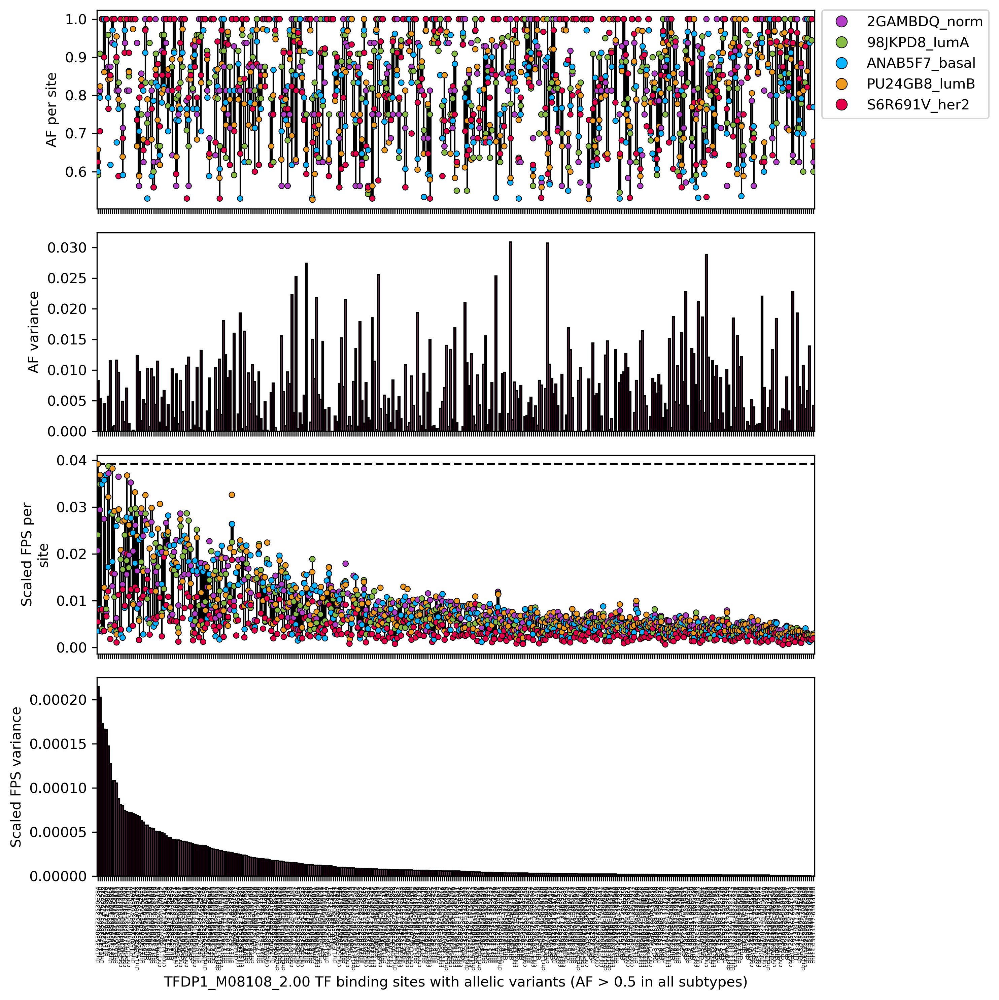

In [75]:
dutchfield_colordict = {'S6R691V_her2': "#e60049", 'ANAB5F7_basal': "#0bb4ff", '98JKPD8_lumA': "#87bc45", 'PU24GB8_lumB': "#ef9b20", '2GAMBDQ_norm': "#b33dc6"}
import textwrap
plt.figure(figsize=(10, 10), dpi=300)
# specify subplot
plt.subplot(4, 1, 1)
sns.boxplot(x='region_id', y='AF', data=high_af_fpsltmean_filtsorted, color='whitesmoke', linecolor='black', showfliers=False)
sns.stripplot(x='region_id', y='AF', data=high_af_fpsltmean_filtsorted, hue='sample_id', palette=dutchfield_colordict, size=4, jitter=True, linewidth=0.5, edgecolor='black')
plt.xticks(ticks=plt.xticks()[0], labels=[])
plt.xlabel('')
ylabel = textwrap.fill('AF per site', width=15)
plt.ylabel(ylabel, fontsize=10)
# place legend outside of the plot
plt.legend(bbox_to_anchor=(1.01, 1),borderaxespad=0, markerscale=2, fontsize=10)

plt.subplot(4, 1, 2)
sns.barplot(x='region_id', y='AF_var', data=high_af_fpsltmean_filtsorted, color='mediumvioletred', edgecolor='black')
plt.xticks(ticks=plt.xticks()[0], labels=[])
plt.xlabel('')
ylabel = textwrap.fill('AF variance', width=15)
plt.ylabel(ylabel, fontsize=10)
  
plt.subplot(4, 1, 3)
sns.boxplot(x='region_id', y='FPS_scaled', data=high_af_fpsltmean_filtsorted, color='whitesmoke', linecolor='black', showfliers=False)
sns.stripplot(x='region_id', y='FPS_scaled', data=high_af_fpsltmean_filtsorted, hue='sample_id', palette=dutchfield_colordict, size=4, jitter=True, legend=False, linewidth=0.5, edgecolor='black')
# plot horizontal line at fps_scaled_global_median
plt.axhline(y=fps_scaled_global_mean, color='black', linestyle='--')
plt.xticks(ticks=plt.xticks()[0], labels=[])
plt.xlabel('')
ylabel = textwrap.fill('Scaled FPS per site', width=15)
plt.ylabel(ylabel, fontsize=10)

plt.subplot(4, 1, 4)
sns.barplot(x='region_id', y='FPS_scaled_var', data=high_af_fpsltmean_filtsorted, color='mediumvioletred', edgecolor='black')
plt.xticks(rotation=90, fontsize=4)
plt.xlabel(f'{motif_id} TF binding sites with allelic variants (AF > 0.5 in all subtypes)', fontsize=10)
plt.ylabel('Scaled FPS variance', fontsize=10)
plt.subplots_adjust(hspace=0.05)
plt.tight_layout()
plt.show()

/Users/sufyazi/Applications/bin/miniforge3/envs/quarto-docs/lib/python3.12/site-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/Users/sufyazi/Applications/bin/miniforge3/envs/quarto-docs/lib/python3.12/site-packages/seaborn/_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
/Users/sufyazi/Applications/bin/miniforge3/envs/quarto-docs/lib/python3.12/site-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/Users/sufyazi/Applications/bin/miniforge3/envs/quarto-docs/lib/python3.12/si

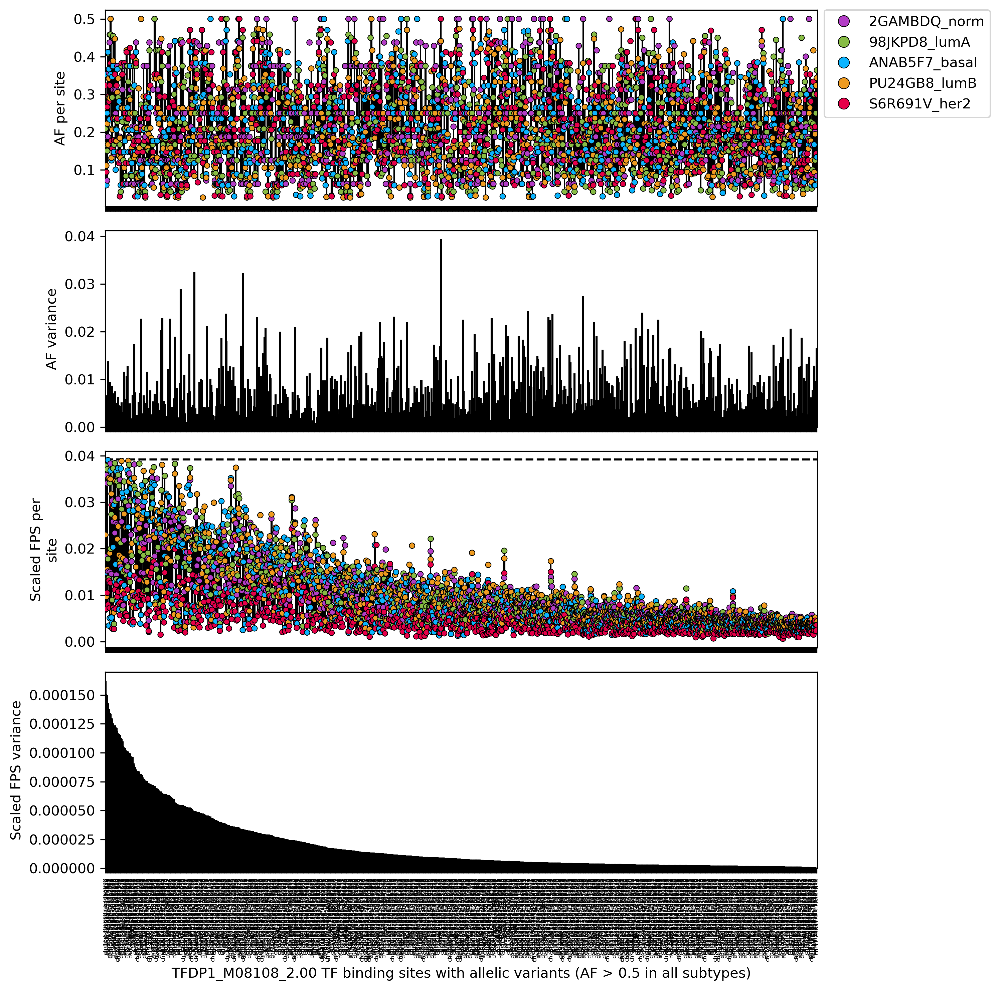

In [76]:
dutchfield_colordict = {'S6R691V_her2': "#e60049", 'ANAB5F7_basal': "#0bb4ff", '98JKPD8_lumA': "#87bc45", 'PU24GB8_lumB': "#ef9b20", '2GAMBDQ_norm': "#b33dc6"}
plt.figure(figsize=(10, 10), dpi=300)
# specify subplot
plt.subplot(4, 1, 1)
sns.boxplot(x='region_id', y='AF', data=low_af_fpsltmean_filtsorted, color='whitesmoke', linecolor='black', showfliers=False)
sns.stripplot(x='region_id', y='AF', data=low_af_fpsltmean_filtsorted, hue='sample_id', palette=dutchfield_colordict, size=4, jitter=True, linewidth=0.5, edgecolor='black')
plt.xticks(ticks=plt.xticks()[0], labels=[])
plt.xlabel('')
ylabel = textwrap.fill('AF per site', width=15)
plt.ylabel(ylabel, fontsize=10)
# place legend outside of the plot
plt.legend(bbox_to_anchor=(1.01, 1),borderaxespad=0, markerscale=2, fontsize=10)

plt.subplot(4, 1, 2)
sns.barplot(x='region_id', y='AF_var', data=low_af_fpsltmean_filtsorted, color='darkolivegreen', edgecolor='black')
plt.xticks(ticks=plt.xticks()[0], labels=[])
plt.xlabel('')
ylabel = textwrap.fill('AF variance', width=15)
plt.ylabel(ylabel, fontsize=10)
  
plt.subplot(4, 1, 3)
sns.boxplot(x='region_id', y='FPS_scaled', data=low_af_fpsltmean_filtsorted, color='whitesmoke', linecolor='black', showfliers=False)
sns.stripplot(x='region_id', y='FPS_scaled', data=low_af_fpsltmean_filtsorted, hue='sample_id', palette=dutchfield_colordict, size=4, jitter=True, legend=False, linewidth=0.5, edgecolor='black')
# plot horizontal line at fps_scaled_global_mean
plt.axhline(y=fps_scaled_global_mean, color='black', linestyle='--')
plt.xticks(ticks=plt.xticks()[0], labels=[])
plt.xlabel('')
ylabel = textwrap.fill('Scaled FPS per site', width=15)
plt.ylabel(ylabel, fontsize=10)

plt.subplot(4, 1, 4)
sns.barplot(x='region_id', y='FPS_scaled_var', data=low_af_fpsltmean_filtsorted, color='darkolivegreen', edgecolor='black')
plt.xticks(rotation=90, fontsize=4)
plt.xlabel(f'{motif_id} TF binding sites with allelic variants (AF > 0.5 in all subtypes)', fontsize=10)
plt.ylabel('Scaled FPS variance', fontsize=10)
plt.subplots_adjust(hspace=0.05)
plt.tight_layout()
plt.show()

#### Strategy 1: Subtype highlighting

For FPS distribution there are subtypes that are more represented that others. Let's try to selectively highlight subtypes which are the maxima per site. 

In [77]:
# Find the index of the max FPS_scaled value for each region_id
idx_max = high_nzaf_filtsorted.groupby('region_id', observed=True)['FPS_scaled'].idxmax()
idx_min = high_nzaf_filtsorted.groupby('region_id', observed=True)['FPS_scaled'].idxmin()
# Select the corresponding rows
max_fps_scaled = high_nzaf_filtsorted.loc[idx_max]
min_fps_scaled = high_nzaf_filtsorted.loc[idx_min]

# do the same for AF
idx_max_af = high_nzaf_filtsorted.groupby('region_id', observed=True)['AF'].idxmax()
idx_min_af = high_nzaf_filtsorted.groupby('region_id', observed=True)['AF'].idxmin()
# Select the corresponding rows
max_af_raw = high_nzaf_filtsorted.loc[idx_max_af]
min_af_raw = high_nzaf_filtsorted.loc[idx_min_af]

In [78]:
# create masks for the inverse of max and min values
mask = ~high_nzaf_filtsorted.index.isin(idx_max)
max_fps_scaled_inv = high_nzaf_filtsorted[mask]

mask = ~high_nzaf_filtsorted.index.isin(idx_min)
min_fps_scaled_inv = high_nzaf_filtsorted[mask]

# do the same for AF
mask = ~high_nzaf_filtsorted.index.isin(idx_max_af)
max_af_raw_inv = high_nzaf_filtsorted[mask]

mask = ~high_nzaf_filtsorted.index.isin(idx_min_af)
min_af_raw_inv = high_nzaf_filtsorted[mask]

In [79]:
# create color dictionary
color_dict = {'S6R691V_her2': "#e60049", 'ANAB5F7_basal': "#0bb4ff", '98JKPD8_lumA': "#87bc45", 'PU24GB8_lumB': "#ef9b20", '2GAMBDQ_norm': "#b33dc6"}
gray = 'lightgray'
color_gray_dict = {'S6R691V_her2': gray, 'ANAB5F7_basal': gray, '98JKPD8_lumA': gray, 'PU24GB8_lumB': gray, '2GAMBDQ_norm': gray}

/Users/sufyazi/Applications/bin/miniforge3/envs/quarto-docs/lib/python3.12/site-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/Users/sufyazi/Applications/bin/miniforge3/envs/quarto-docs/lib/python3.12/site-packages/seaborn/_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
/Users/sufyazi/Applications/bin/miniforge3/envs/quarto-docs/lib/python3.12/site-packages/seaborn/_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
/Users

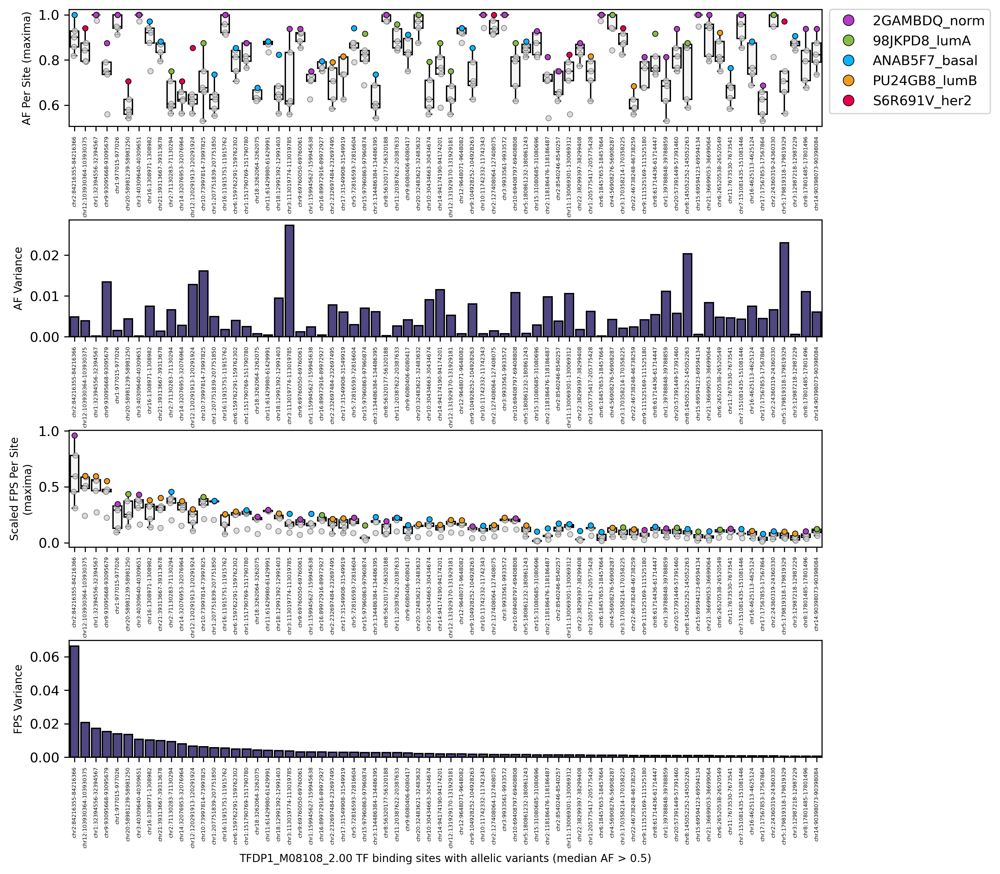

In [80]:
plt.figure(figsize=(10, 10), dpi=300)
# specify subplot
plt.subplot(4, 1, 1)
sns.boxplot(x='region_id', y='AF', data=high_nzaf_filtsorted, color='whitesmoke', linecolor='black', showfliers=False)
sns.stripplot(x='region_id', y='AF', data=max_af_raw_inv, hue='sample_id', palette=color_gray_dict, size=4, jitter=True, legend=False, linewidth=0.5, edgecolor='dimgray', alpha=0.8)
sns.stripplot(x='region_id', y='AF', data=max_af_raw, hue='sample_id', palette=color_dict, size=4, jitter=True, linewidth=0.5, edgecolor='black')
plt.xticks(rotation=90, fontsize=4)
plt.xlabel('')
ylabel = textwrap.fill('AF Per Site (maxima)', width=20)
plt.ylabel(ylabel, fontsize=8)
# place legend outside of the plot
plt.legend(bbox_to_anchor=(1.01, 1),borderaxespad=0, markerscale=2, fontsize=10)
plt.subplot(4, 1, 2)
sns.barplot(x='region_id', y='AF_var', data=high_nzaf_filtsorted, color='darkslateblue', edgecolor='black')
plt.xticks(rotation=90, fontsize=4)
plt.xlabel('')
plt.ylabel('AF Variance', fontsize=8)
  
plt.subplot(4, 1, 3)
sns.boxplot(x='region_id', y='FPS_scaled', data=high_nzaf_filtsorted, color='whitesmoke', linecolor='black', showfliers=False)
sns.stripplot(x='region_id', y='FPS_scaled', data=max_fps_scaled_inv, hue='sample_id', palette=color_gray_dict, size=4, jitter=True, legend=False, linewidth=0.5, edgecolor='dimgray', alpha=0.8)
sns.stripplot(x='region_id', y='FPS_scaled', data=max_fps_scaled, hue='sample_id', palette=color_dict, size=4, jitter=True, legend=False, linewidth=0.5, edgecolor='black')
plt.xticks(rotation=90, fontsize=4)
plt.xlabel('')
ylabel = textwrap.fill('Scaled FPS Per Site (maxima)', width=20)
plt.ylabel(ylabel, fontsize=8)

plt.subplot(4, 1, 4)
sns.barplot(x='region_id', y='FPS_scaled_var', data=high_nzaf_filtsorted, color='darkslateblue', edgecolor='black')
plt.xticks(rotation=90, fontsize=4)
plt.xlabel(f'{motif_id} TF binding sites with allelic variants (median AF > 0.5)', fontsize=8)
plt.ylabel('FPS Variance', fontsize=8)
plt.subplots_adjust(hspace=0.8)

plt.show()

In [81]:
high_nzaf_filtsorted

,region_id,sample_id,AF,FPS,FPS_scaled,FPS_var,FPS_scaled_var,AF_var
0,chr2:84216355-84216366,2GAMBDQ_norm,0.928571,3.60913,0.958827,0.480584,0.066372,0.004836
1,chr2:84216355-84216366,98JKPD8_lumA,0.818182,2.24927,0.593228,0.480584,0.066372,0.004836
2,chr2:84216355-84216366,ANAB5F7_basal,1.000000,1.79019,0.454815,0.480584,0.066372,0.004836
3,chr2:84216355-84216366,PU24GB8_lumB,0.900000,2.86361,0.779286,0.480584,0.066372,0.004836
4,chr2:84216355-84216366,S6R691V_her2,0.857143,2.35684,0.308047,0.480584,0.066372,0.004836
...,...,...,...,...,...,...,...,...
345,chr14:90398073-90398084,2GAMBDQ_norm,0.937500,0.34468,0.091570,0.002642,0.000669,0.006053
346,chr14:90398073-90398084,98JKPD8_lumA,0.875000,0.47013,0.123993,0.002642,0.000669,0.006053
347,chr14:90398073-90398084,ANAB5F7_basal,0.823529,0.43186,0.109718,0.002642,0.000669,0.006053
348,chr14:90398073-90398084,PU24GB8_lumB,0.789474,0.44464,0.121002,0.002642,0.000669,0.006053


In [82]:
# spearman correlation between AF and FPS_scaled for each subtype in the high_nzaf_filtsorted dataframe; it will tell you that when you rank the FPS values across all sites for one subtype, do you see a similar ranking for AF values across all sites for that subtype

import scipy.stats as stats

for subtype in high_nzaf_filtsorted['sample_id'].unique():
	corr_df = high_nzaf_filtsorted[high_nzaf_filtsorted['sample_id'] == subtype].copy()
	correlation, pvalue = stats.spearmanr(corr_df['FPS_scaled'], corr_df['AF'])
	print(subtype, correlation, pvalue)

2GAMBDQ_norm -0.07043233370514121 0.562326669195969
98JKPD8_lumA -0.06794254660134656 0.5762577789484744
ANAB5F7_basal -0.1204524791162335 0.3205860752059085
PU24GB8_lumB -0.07550600951827419 0.5344406071769667
S6R691V_her2 -0.09221847208208683 0.4476834320040459


In [83]:
# quantify the number of filtered sites per sample_id
max_af_raw_subset = max_af_raw[['region_id', 'sample_id']]
max_af_raw_df = max_af_raw_subset.groupby('sample_id', observed=False)['region_id'].count().to_frame()

In [84]:
max_af_raw_df

,region_id
sample_id,
2GAMBDQ_norm,26
98JKPD8_lumA,13
ANAB5F7_basal,18
PU24GB8_lumB,5
S6R691V_her2,8


In [85]:
max_fps_scaled_subset = max_fps_scaled[['region_id', 'sample_id']]
max_fps_scaled_df = max_fps_scaled_subset.groupby('sample_id', observed=False)['region_id'].count().to_frame()

In [86]:
max_fps_scaled_df

,region_id
sample_id,
2GAMBDQ_norm,14
98JKPD8_lumA,9
ANAB5F7_basal,23
PU24GB8_lumB,24
S6R691V_her2,0
